<a href="https://colab.research.google.com/github/narendraakumar/SDNAWORK/blob/main/duplicate_finder_sift.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
!pip install rembg
!pip install onnxruntime
!pip install opencv-python

In [8]:
from rembg import remove
import numpy as np
import cv2
from PIL import Image
import io
import glob


In [9]:

def find_most_central_bbox(bboxes, image_size):
    # Image dimensions (width, height)
    img_width, img_height = image_size
    img_center = (img_width / 2, img_height / 2)

    centralized_bbox = None
    min_distance = float('inf')

    for bbox in bboxes:
        # bbox = [x_min, y_min, x_max, y_max]
        x_min, y_min, x_max, y_max = bbox
        x_center = x_min + (x_max - x_min) / 2
        y_center = y_min + (y_max - y_min) / 2

        # Calculate distance to image center
        distance = np.sqrt((x_center - img_center[0])**2 + (y_center - img_center[1])**2)

        # Update minimum distance and bounding box
        if distance < min_distance:
            min_distance = distance
            centralized_bbox = bbox

    return centralized_bbox

def remove_hero_product(input_path):
  with open(input_path, "rb") as f:
      input_image = f.read()
  output_image = remove(input_image)

  image_without_bg = np.array(Image.open(io.BytesIO(output_image)))
  if image_without_bg.shape[-1] == 4:  # If image has 4 channels (RGBA)
    image_without_bg = cv2.cvtColor(image_without_bg, cv2.COLOR_RGBA2RGB)
  gray_image = cv2.cvtColor(image_without_bg, cv2.COLOR_BGR2GRAY)
  _, thresh = cv2.threshold(gray_image, 1, 255, cv2.THRESH_BINARY)
  contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  bboxes = []
  im2 = cv2.imread(input_path)
  for contour in contours:
      x, y, w, h = cv2.boundingRect(contour)
      if h < 30 or w<30:
        continue
      bboxes.append([x,y,x+w,y+h])
  if len(bboxes)>1:
    bboxes = [find_most_central_bbox(bboxes,gray_image.shape[:2])]
  for bbox in bboxes:
    x, y, x2, y2 = bbox
    w = x2-x
    h = y2-y
    cv2.rectangle(image_without_bg, (x, y), (x + w, y + h), (0, 255, 0), 2)
    # bbox.append([x,y,x+w,y+h])
    im2[y:y+h, x:x+w] = [255, 255, 255]
  image_name = input_path.split("/")[-1].split(".")[0]
  output_path = input_path.replace(image_name, image_name+"_hero_removed")
  cv2.imwrite(output_path, im2)
  return bboxes,output_path

# remove_hero_product("/content/1-1.png")

In [5]:
import cv2

def compare_sift(img1, img2):
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    print(kp1,des1)
    import pdb;pdb.set_trace()
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)
    print(len(matches))
    good_matches = [m for m, n in matches if m.distance < 0.55 * n.distance]
    return len(good_matches)


img1 = cv2.imread(f"/content/1730878499978_AANZ1751_02.png")
img2 = cv2.imread(f"/content/1730878683078_CBOV2839_02.png")
s = compare_sift(img1, img2)
print(s)
# for i in range(1,7):
#   for j in range(1,7):
#     if i==j:
#       continue
#     img1 = cv2.imread(f"/content/{i}_hero_removed.png")
#     img2 = cv2.imread(f"/content/{j}_hero_removed.png")
#     s = compare_sift(img1, img2)

#     if s>40:
#       print(i,j,s)


PYDEV DEBUGGER WARNING:
sys.settrace() should not be used when the debugger is being used.
This may cause the debugger to stop working correctly.
If this is needed, please check: 
http://pydev.blogspot.com/2007/06/why-cant-pydev-debugger-work-with.html
to see how to restore the debug tracing back correctly.
Call Location:
  File "/usr/lib/python3.10/bdb.py", line 336, in set_trace
    sys.settrace(self.trace_dispatch)



(< cv2.KeyPoint 0x7a7b25b12160>, < cv2.KeyPoint 0x7a7b25b13510>, < cv2.KeyPoint 0x7a7b25b10e40>, < cv2.KeyPoint 0x7a7b25b11a40>, < cv2.KeyPoint 0x7a7b25b11ad0>, < cv2.KeyPoint 0x7a7b25b13240>, < cv2.KeyPoint 0x7a7b25b11d10>, < cv2.KeyPoint 0x7a7b25b118f0>, < cv2.KeyPoint 0x7a7b25b11bc0>, < cv2.KeyPoint 0x7a7b25b11bf0>, < cv2.KeyPoint 0x7a7b25b12850>, < cv2.KeyPoint 0x7a7b25b11aa0>, < cv2.KeyPoint 0x7a7b25b134e0>, < cv2.KeyPoint 0x7a7b25b13840>, < cv2.KeyPoint 0x7a7b25b13570>, < cv2.KeyPoint 0x7a7b25b10fc0>, < cv2.KeyPoint 0x7a7b25b11b00>, < cv2.KeyPoint 0x7a7b25b131e0>, < cv2.KeyPoint 0x7a7b25b11800>, < cv2.KeyPoint 0x7a7b25b111a0>, < cv2.KeyPoint 0x7a7ae36344e0>, < cv2.KeyPoint 0x7a7ae3635e00>, < cv2.KeyPoint 0x7a7ae36345d0>, < cv2.KeyPoint 0x7a7ae3636f10>, < cv2.KeyPoint 0x7a7ae3637f00>, < cv2.KeyPoint 0x7a7ae3636b80>, < cv2.KeyPoint 0x7a7ae3636280>, < cv2.KeyPoint 0x7a7ae3634cf0>, < cv2.KeyPoint 0x7a7ae3636a60>, < cv2.KeyPoint 0x7a7ae3637de0>, < cv2.KeyPoint 0x7a7ae3634ea0>, < cv2.K


PYDEV DEBUGGER WARNING:
sys.settrace() should not be used when the debugger is being used.
This may cause the debugger to stop working correctly.
If this is needed, please check: 
http://pydev.blogspot.com/2007/06/why-cant-pydev-debugger-work-with.html
to see how to restore the debug tracing back correctly.
Call Location:
  File "/usr/lib/python3.10/bdb.py", line 361, in set_quit
    sys.settrace(None)


PYDEV DEBUGGER WARNING:
sys.settrace() should not be used when the debugger is being used.
This may cause the debugger to stop working correctly.
If this is needed, please check: 
http://pydev.blogspot.com/2007/06/why-cant-pydev-debugger-work-with.html
to see how to restore the debug tracing back correctly.
Call Location:
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/debugger.py", line 1075, in cmdloop
    sys.settrace(None)



--KeyboardInterrupt--

KeyboardInterrupt: Interrupted by user


KeyboardInterrupt: 

['/content/1730965539199_CBOP5242_01.png', '/content/1730984266040_CBXL8105_02.png', '/content/1730881336090_CBUO9583_1.png', '/content/1730976869235_FHNF5202_02.png', '/content/1730881931745_CBXQ2983_01.png', '/content/1730979974618_CBOQ4046_02.png', '/content/1730984978127_CBOX3867_02.png', '/content/1730882984773_CBUO2740_2.png', '/content/1731054404495_CBOZ5231_01.png', '/content/1730894668719_CBOX3592_02.png', '/content/1730899540975_CBXU3694_01.png', '/content/1731062874328_CBUV3843_02.png', '/content/1730977578283_CBUO8769_01.png', '/content/1730954695491_ESUR6086_02.png', '/content/1730881417396_CAFV5018_1.png', '/content/1730980217099_CBUP2238_01.png', '/content/1731057198275_CBUW3902_02.png', '/content/1731052415522_CBOX6655_02.png', '/content/1730958665684_CBOX3817_01.png', '/content/1730890450156_CBXL9819_02.png', '/content/1730956934541_ESUR9469_02.png', '/content/1730890916289_CBXM2361_01.png', '/content/1730981330301_CBUX9207_02.png', '/content/1730962587619_CBUV2549_02.

100%|████████████████████████████████████████| 176M/176M [00:00<00:00, 113GB/s]


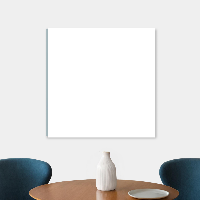

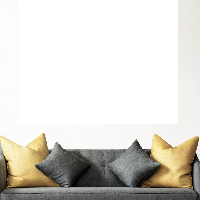

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730881336090_CBUO9583_1.png


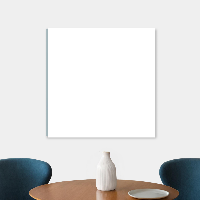

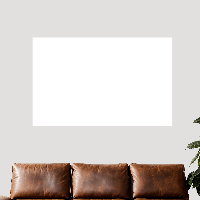

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730976869235_FHNF5202_02.png


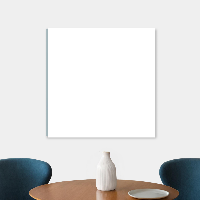

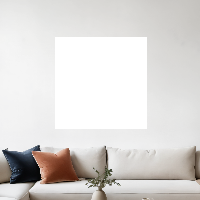

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730881931745_CBXQ2983_01.png


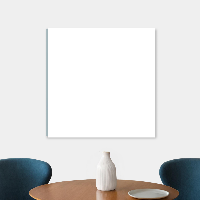

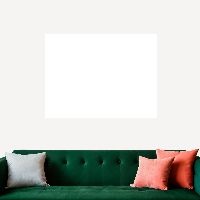

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730979974618_CBOQ4046_02.png


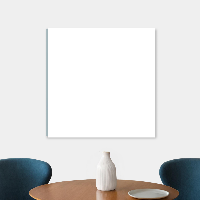

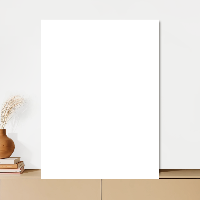

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730984978127_CBOX3867_02.png


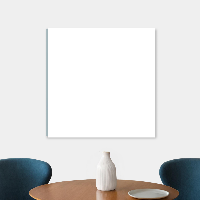

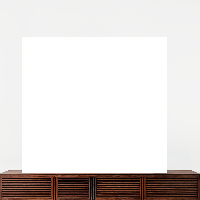

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730882984773_CBUO2740_2.png


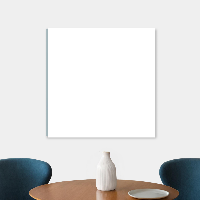

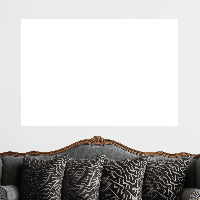

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1731054404495_CBOZ5231_01.png


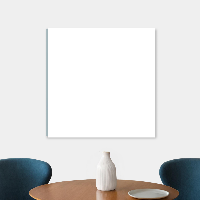

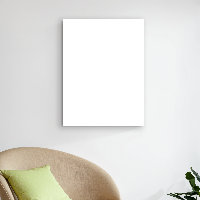

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730894668719_CBOX3592_02.png


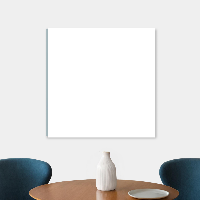

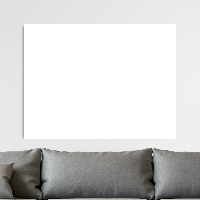

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730899540975_CBXU3694_01.png


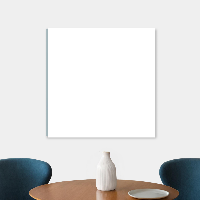

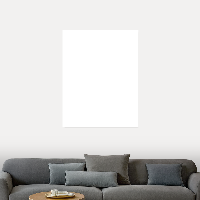

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1731062874328_CBUV3843_02.png


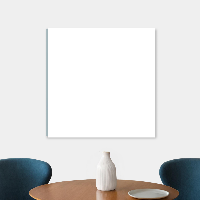

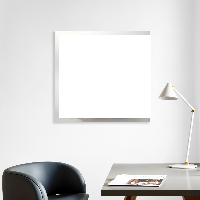

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730977578283_CBUO8769_01.png


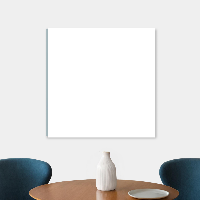

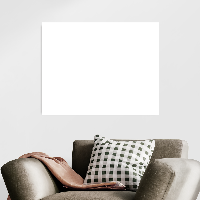

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730954695491_ESUR6086_02.png


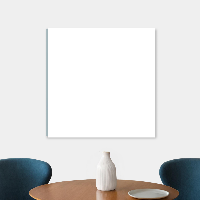

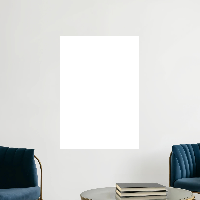

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730881417396_CAFV5018_1.png


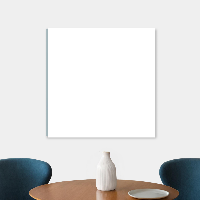

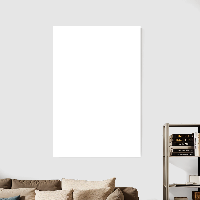

ssssssssssssssssssss
12
12
/content/1730965539199_CBOP5242_01.png /content/1730980217099_CBUP2238_01.png


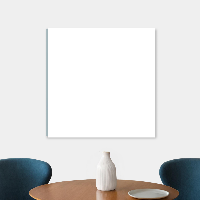

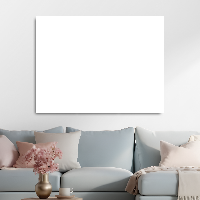

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1731057198275_CBUW3902_02.png


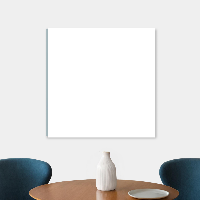

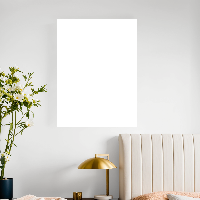

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1731052415522_CBOX6655_02.png


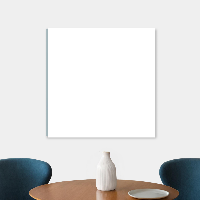

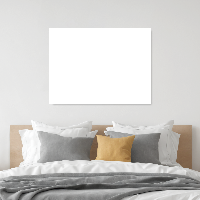

ssssssssssssssssssss
4
4
/content/1730965539199_CBOP5242_01.png /content/1730958665684_CBOX3817_01.png


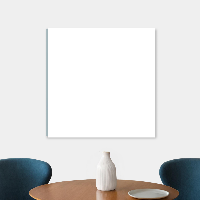

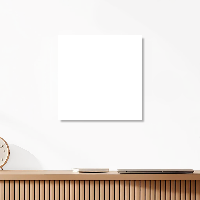

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730890450156_CBXL9819_02.png


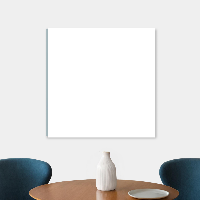

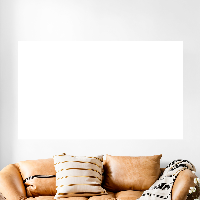

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730956934541_ESUR9469_02.png


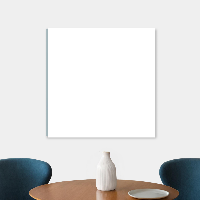

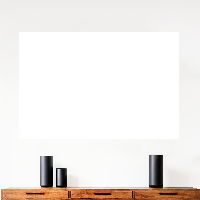

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730890916289_CBXM2361_01.png


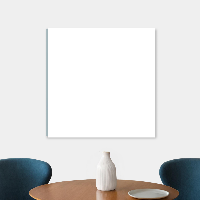

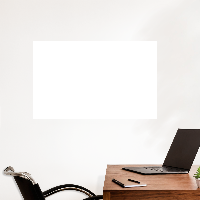

ssssssssssssssssssss
6
6
/content/1730965539199_CBOP5242_01.png /content/1730981330301_CBUX9207_02.png


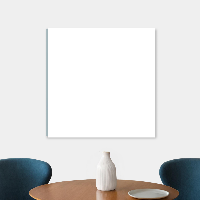

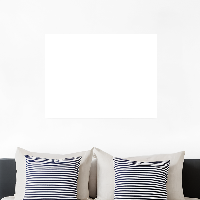

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730962587619_CBUV2549_02.png


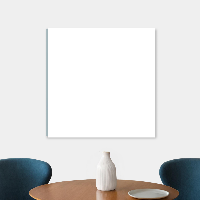

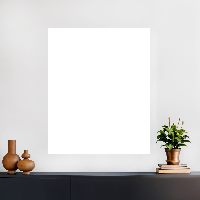

ssssssssssssssssssss
5
5
/content/1730965539199_CBOP5242_01.png /content/1730973588074_CBUO7390_01.png


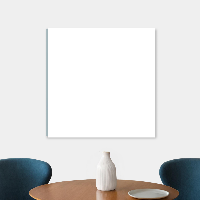

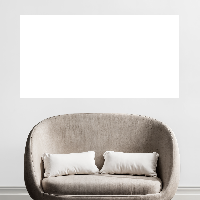

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730878683078_CBOV2839_02.png


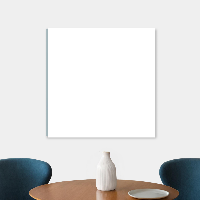

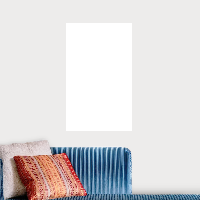

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730983645923_FCAC4876_01.png


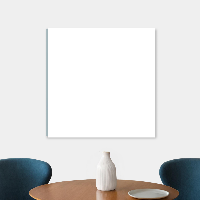

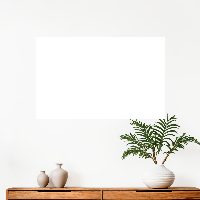

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730966532252_CBOP5765_01.png


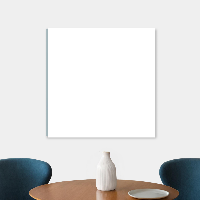

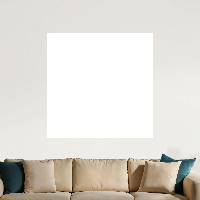

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730980001011_CBUP1789_02.png


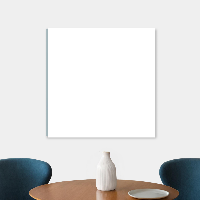

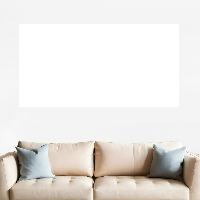

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730979099908_CBOX1597_02.png


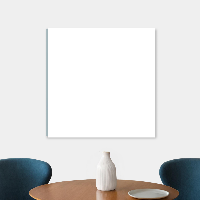

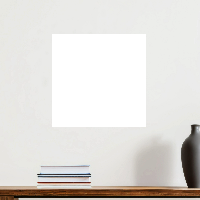

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730970715911_CBXQ5404_02.png


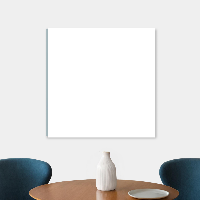

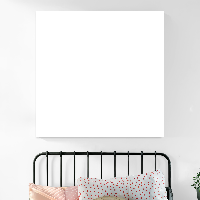

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730889952522_CBOO9450_01.png


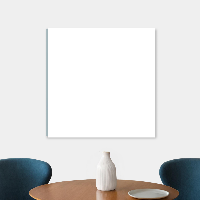

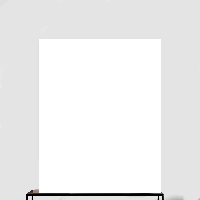

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730971733615_FCAD3580_02.png


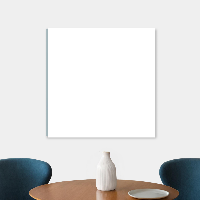

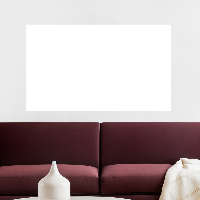

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730968011564_CBOQ4075_02.png


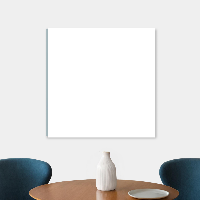

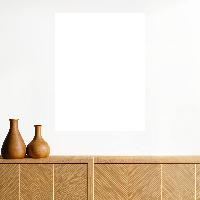

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730960010399_CBOX4716_01.png


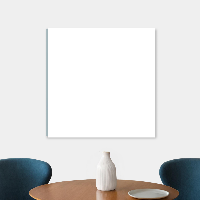

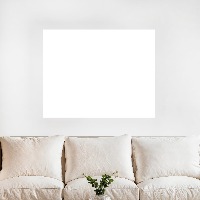

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730974139291_CBUO8227_01.png


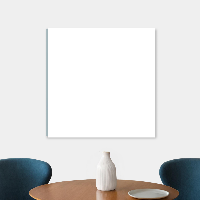

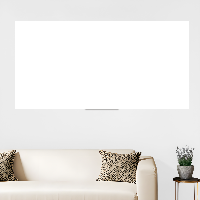

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730963757543_DVOA3335_02.png


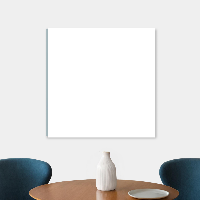

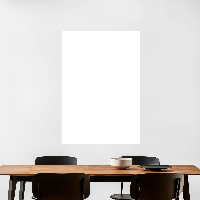

ssssssssssssssssssss
21
21
/content/1730965539199_CBOP5242_01.png /content/1730980989257_CBUV2544_02.png


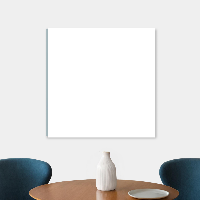

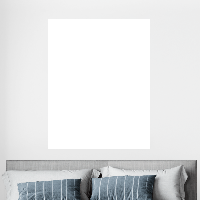

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730962093986_CBXQ2440_02.png


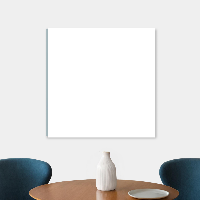

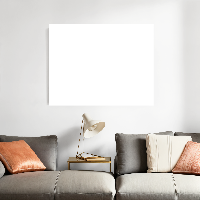

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1731063218973_CBUP1334_02.png


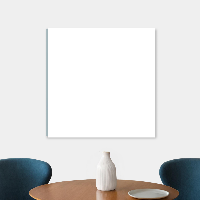

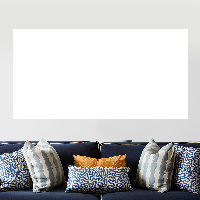

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730958880241_CBOO8938_02.png


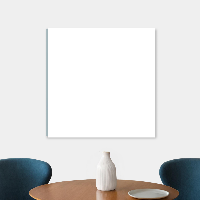

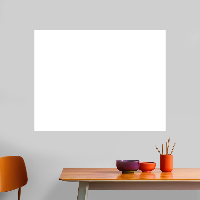

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730959297097_Untitled_(9).png


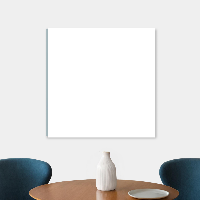

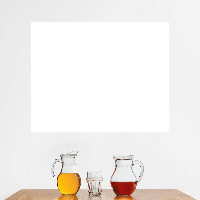

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730983858316_CBOX3494_01.png


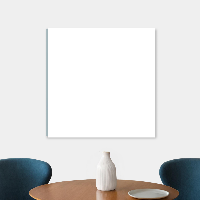

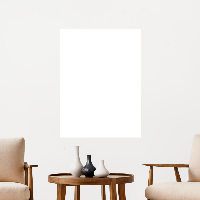

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730893521669_CBOX3900_01.png


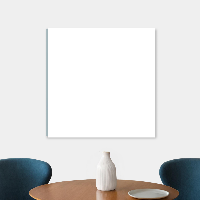

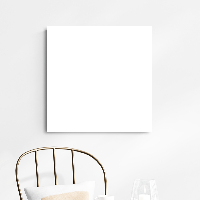

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730959192351_CBOO6412_01.png


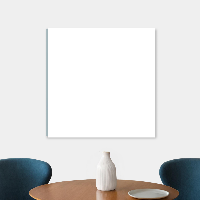

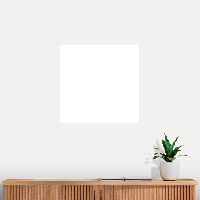

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730964702500_CBOP2736_02.png


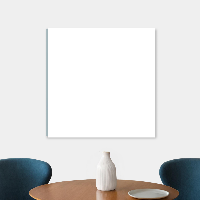

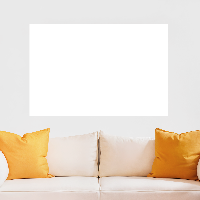

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730888057076_CBXU4571-1.png


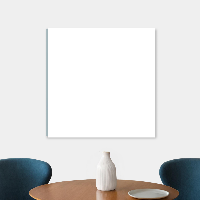

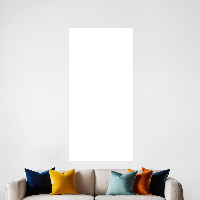

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730878802102_CBOX3990_021.png


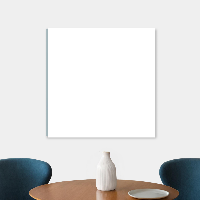

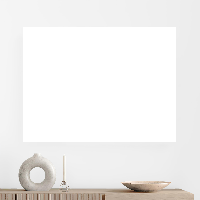

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730976715879_FCAD8351_01.png


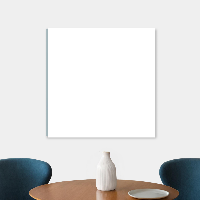

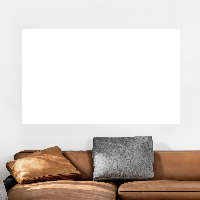

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730979001382_CBUO8952_02.png


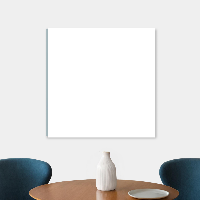

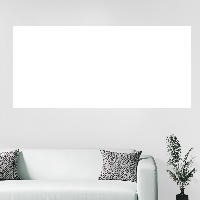

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730966640765_ETRB4172_01.png


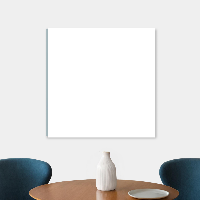

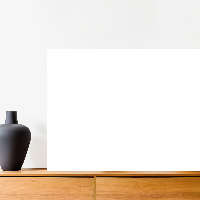

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1731043937727_CBOZ5926_01.png


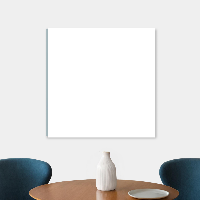

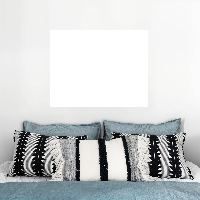

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730891364546_CBXQ2897_02.png


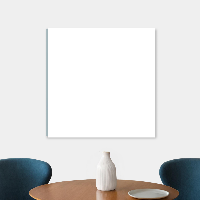

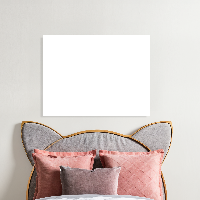

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730957605291_CBOO8632_01.png


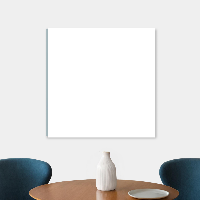

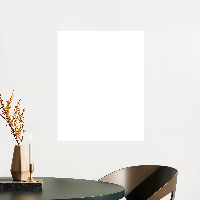

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730992368695_CBXQ3214_01.png


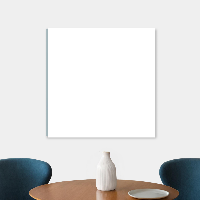

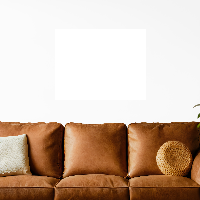

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730985279974_CBUW4010_02.png


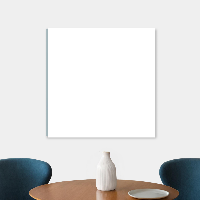

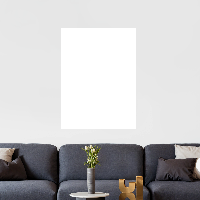

ssssssssssssssssssss
6
6
/content/1730965539199_CBOP5242_01.png /content/1730890037614_CBXL9805_01.png


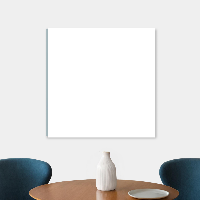

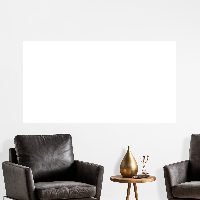

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730878499978_AANZ1751_02.png


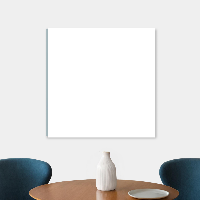

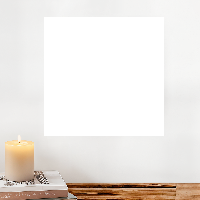

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730964578932_CBXQ2659_01.png


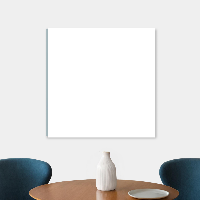

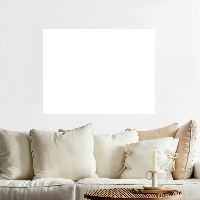

ssssssssssssssssssss
5
5
/content/1730965539199_CBOP5242_01.png /content/1730971809198_AANZ1391_02.png


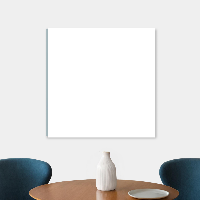

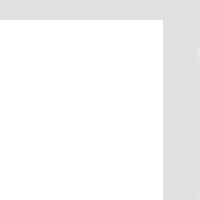

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730891431057_CBOW9334_01.png


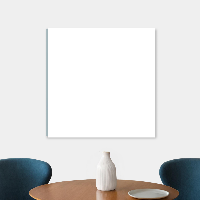

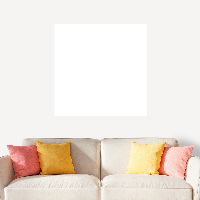

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1731053492827_CBUP3424_01.png


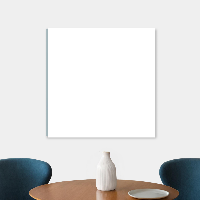

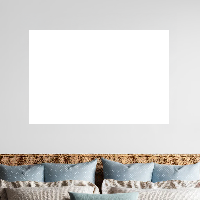

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1731063250023_CBUP1576_01.png


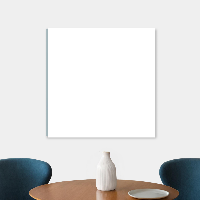

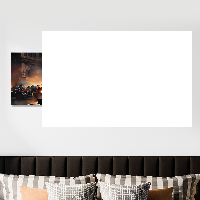

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730956741721_CBUQ1706_02.png


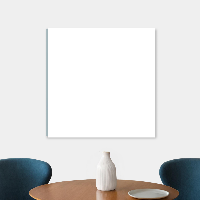

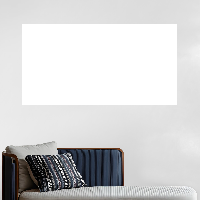

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730891231963_CBXQ2709_01.png


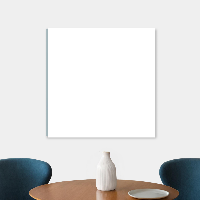

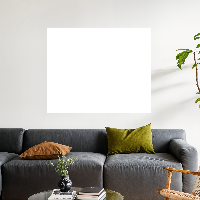

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730880373571_FHNF8612_01.png


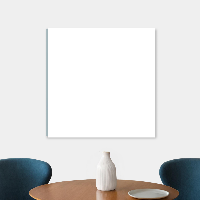

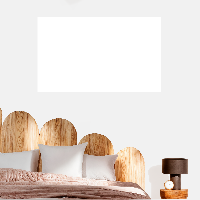

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730955953488_CBXU3279_2.png


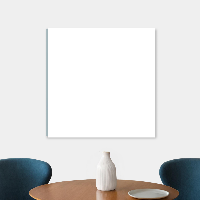

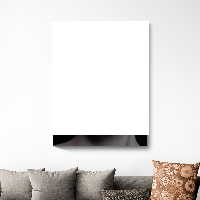

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730961556718_ETRB3284_02.png


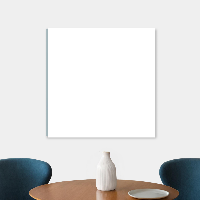

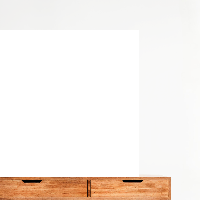

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730978548584_CBOP9917_02.png


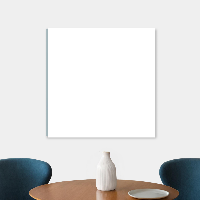

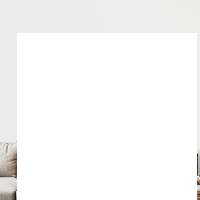

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730974953970_FCAE8924_02.png


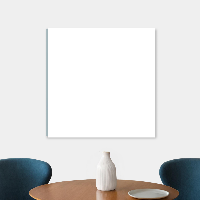

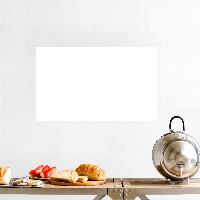

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730974388429_FCAE7958_01.png


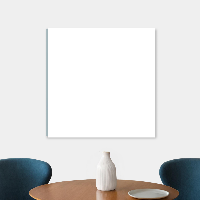

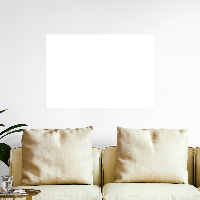

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730958036609_CBOX3861_01.png


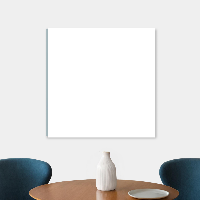

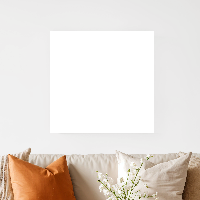

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1731041981454_BYST6518_1.png


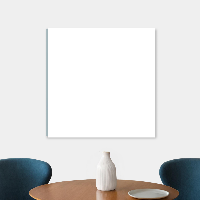

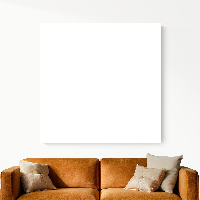

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730977079734_CBOQ8103_01.png


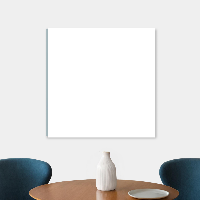

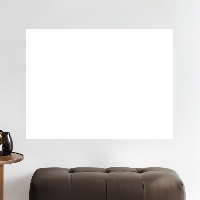

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730890521099_CBXM2106_01.png


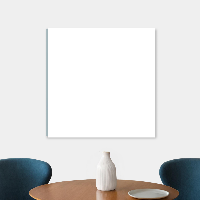

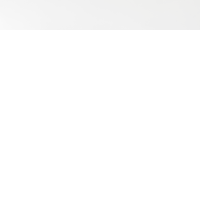

ssssssssssssssssssss
0
0
/content/1730965539199_CBOP5242_01.png /content/1730889893922_CBOO5742_02.png


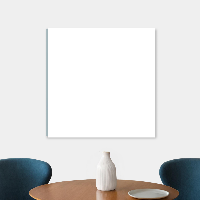

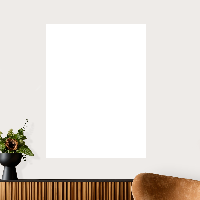

ssssssssssssssssssss
4
4
/content/1730965539199_CBOP5242_01.png /content/1730963369403_CBXQ2638_01.png


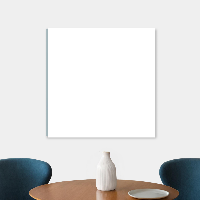

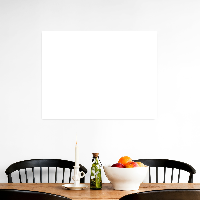

ssssssssssssssssssss
3
3
/content/1730965539199_CBOP5242_01.png /content/1730982941038_CBUW3987_02.png


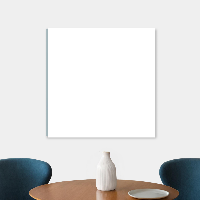

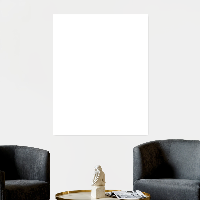

ssssssssssssssssssss
1
1
/content/1730965539199_CBOP5242_01.png /content/1730899768468_CBXU3674_01.png


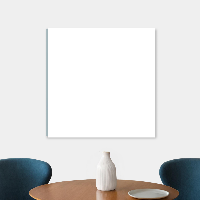

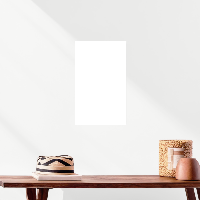

ssssssssssssssssssss
2
2
/content/1730965539199_CBOP5242_01.png /content/1730973444931_CBOX3822_01.png


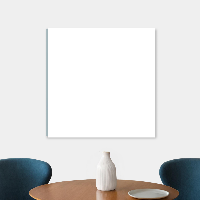

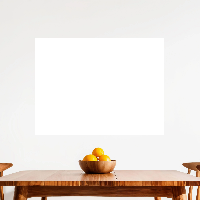

ssssssssssssssssssss
0
0
/content/1730984266040_CBXL8105_02.png /content/1730881336090_CBUO9583_1.png


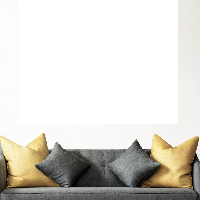

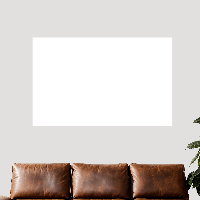

ssssssssssssssssssss
4
4
/content/1730984266040_CBXL8105_02.png /content/1730976869235_FHNF5202_02.png


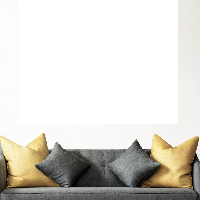

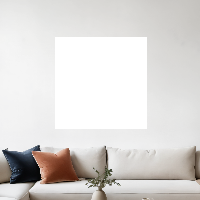

ssssssssssssssssssss
2
2
/content/1730984266040_CBXL8105_02.png /content/1730881931745_CBXQ2983_01.png


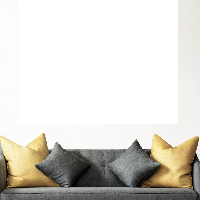

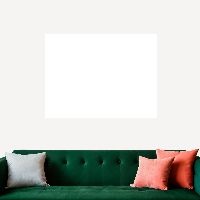

ssssssssssssssssssss
0
0
/content/1730984266040_CBXL8105_02.png /content/1730979974618_CBOQ4046_02.png


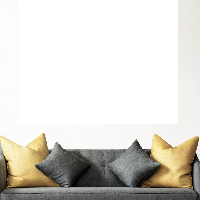

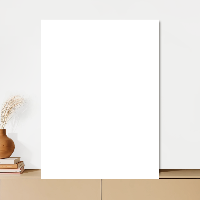

ssssssssssssssssssss
4
4
/content/1730984266040_CBXL8105_02.png /content/1730984978127_CBOX3867_02.png


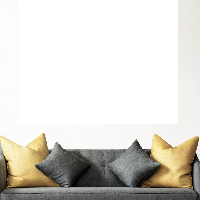

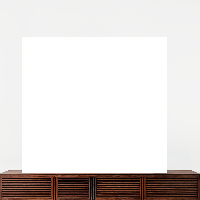

ssssssssssssssssssss
4
4
/content/1730984266040_CBXL8105_02.png /content/1730882984773_CBUO2740_2.png


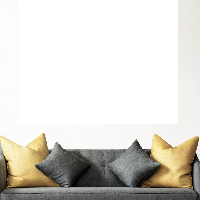

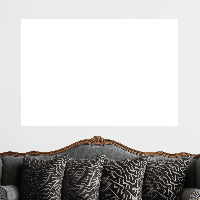

ssssssssssssssssssss
1
1
/content/1730984266040_CBXL8105_02.png /content/1731054404495_CBOZ5231_01.png


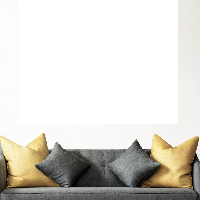

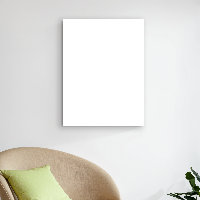

ssssssssssssssssssss
18
18
/content/1730984266040_CBXL8105_02.png /content/1730894668719_CBOX3592_02.png


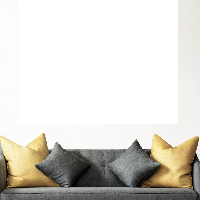

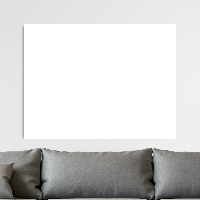

ssssssssssssssssssss
1
1
/content/1730984266040_CBXL8105_02.png /content/1730899540975_CBXU3694_01.png


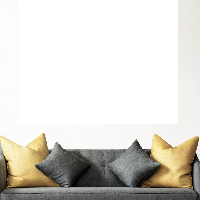

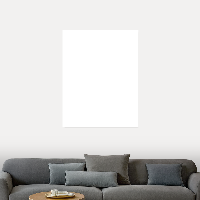

ssssssssssssssssssss
3
3
/content/1730984266040_CBXL8105_02.png /content/1731062874328_CBUV3843_02.png


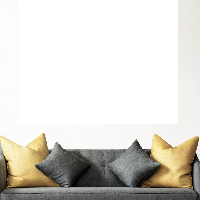

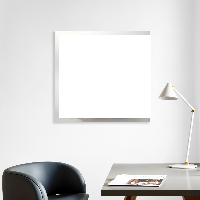

ssssssssssssssssssss
7
7
/content/1730984266040_CBXL8105_02.png /content/1730977578283_CBUO8769_01.png


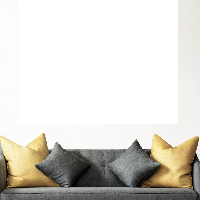

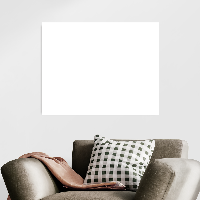

ssssssssssssssssssss
0
0
/content/1730984266040_CBXL8105_02.png /content/1730954695491_ESUR6086_02.png


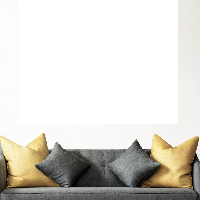

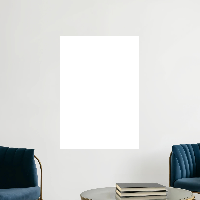

ssssssssssssssssssss
9
9
/content/1730984266040_CBXL8105_02.png /content/1730881417396_CAFV5018_1.png


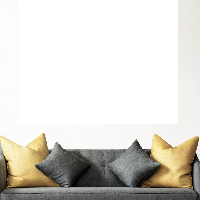

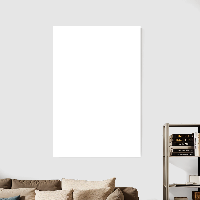

ssssssssssssssssssss
10
10
/content/1730984266040_CBXL8105_02.png /content/1730980217099_CBUP2238_01.png


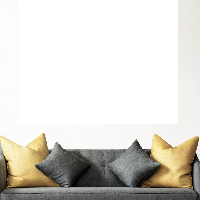

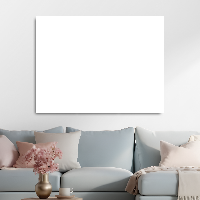

ssssssssssssssssssss
2
2
/content/1730984266040_CBXL8105_02.png /content/1731057198275_CBUW3902_02.png


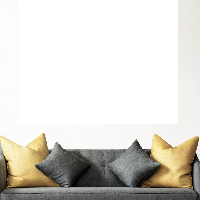

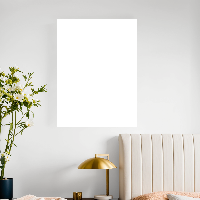

In [ ]:
import glob
from rembg import remove
import numpy as np
import cv2
from PIL import Image
import io
from google.colab.patches import cv2_imshow

def show_image(f):
  if isinstance(f,str):
    img1 = cv2.imread(f)
  else:
    img1 = f
  img1 = cv2.resize(img1, (200, 200))
  cv2_imshow(img1)


def compare_sift(img1, img2):
    img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)

    good_matches = [m for m, n in matches if m.distance < 0.55 * n.distance]
    return len(good_matches)


def is_dup(im1,im2):
  _,im1_ = remove_hero_product(im1)
  _,im2_ = remove_hero_product(im2)
  show_image(im1_)
  show_image(   im2_)
  img1 = cv2.imread(im1)
  img2 = cv2.imread(im2)
  try:
    s = compare_sift(img1, img2)
    print("s"*20)
    print(s)
  except Exception as e:
    import traceback
    print(traceback.format_exc())
    print("image failure")
    return False

  if s>40:
    return True
  else:
    return False

def is_dup2(im1,im2):
  # _,im1_ = remove_hero_product(im1)
  # _,im2_ = remove_hero_product(im2)

  img1 = cv2.imread(im1)
  img2 = cv2.imread(im2)
  try:
    s = compare_sift(img1, img2)
    print(s)
  except Exception as e:
    import traceback
    print(traceback.format_exc())
    print("image failure")
    return False

  if s>40:
    return True
  else:
    return False

def is_dup_fname(fname1, fname2):
	fname1 = fname1.split(".")[0]
	base_name1 = fname1.split("-")[0]

	fname2 = fname2.split(".")[0]
	base_name2 = fname2.split("-")[0]

	if base_name1 == base_name2:
		return True

	return False


accuracy = 0
# all_files = [f for f in glob.glob("/content/*.png") if f.split("/")[-1].split(".")[0] in ["3","3-1","3-4"]]
all_files = [f for f in glob.glob("/content/*.png")]
all_files = [f for f in all_files if "hero_removed" not in f]
print(all_files)
all_d =[]
compared = []
for fname1 in all_files:
  for fname2 in all_files:
    if fname1 == fname2:
      continue
    if [fname2,fname1] in compared:
      continue
    compared.append([fname1,fname2])
    print(fname1,fname2)
    is_dup_flag = is_dup(fname1, fname2)
    is_dup_flag2 = is_dup2(fname1, fname2)
    is_dup_flag_ = is_dup_flag or is_dup_flag2
    ground_truth_flag = is_dup_fname(fname1, fname2)
    all_d.append([fname1,fname2,is_dup_flag,is_dup_flag2,is_dup_flag_,ground_truth_flag])
    if is_dup_flag_ == ground_truth_flag:
      accuracy += 1
    else:
      print(is_dup_flag_,ground_truth_flag)
      print("not match")
print(all_d)
print(accuracy,len(all_files))
print("Accuracy = ", accuracy,len(all_files))

['/content/1730881336090_CBUO9583_1.png', '/content/1730881931745_CBXQ2983_01.png', '/content/1730882984773_CBUO2740_2.png', '/content/1730881417396_CAFV5018_1.png', '/content/1730878683078_CBOV2839_02.png', '/content/1730888057076_CBXU4571-1.png', '/content/1730878802102_CBOX3990_021.png', '/content/1730878499978_AANZ1751_02.png', '/content/1730880373571_FHNF8612_01.png']


100%|███████████████████████████████████████| 176M/176M [00:00<00:00, 28.9GB/s]


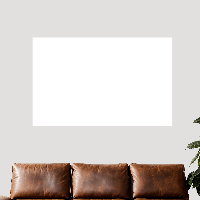

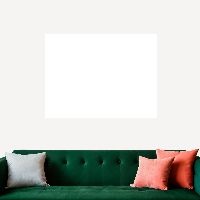

ssssssssssssssssssss
1
1


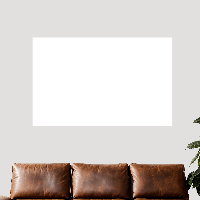

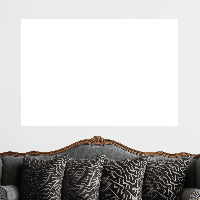

ssssssssssssssssssss
0
0


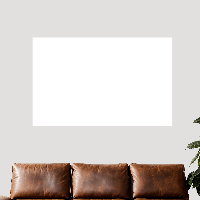

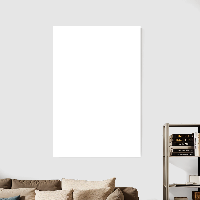

ssssssssssssssssssss
10
10


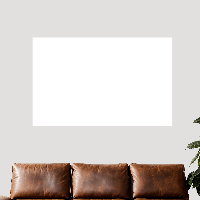

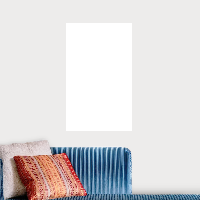

ssssssssssssssssssss
2
2


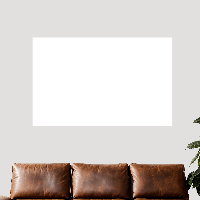

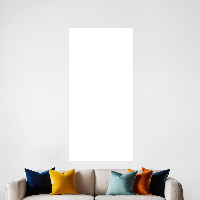

ssssssssssssssssssss
2
2


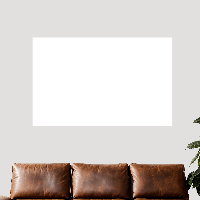

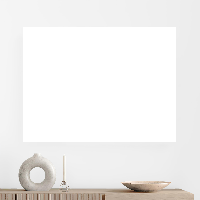

ssssssssssssssssssss
1
1


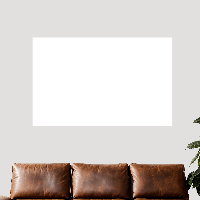

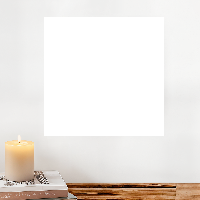

ssssssssssssssssssss
0
0


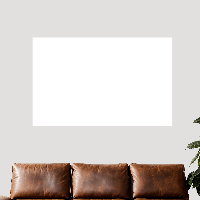

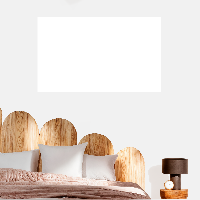

ssssssssssssssssssss
0
0


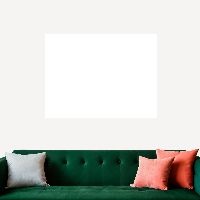

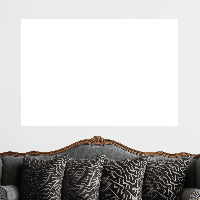

ssssssssssssssssssss
0
0


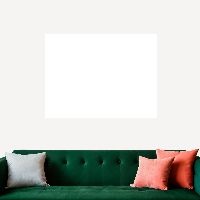

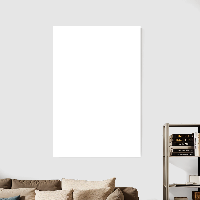

ssssssssssssssssssss
4
4


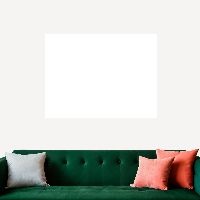

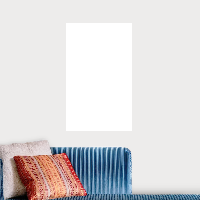

ssssssssssssssssssss
2
2


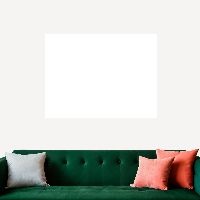

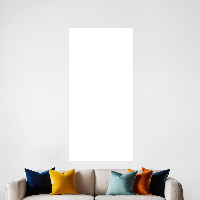

ssssssssssssssssssss
4
4


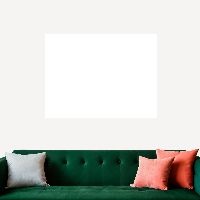

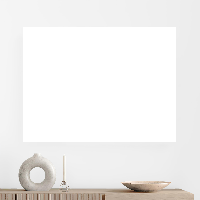

ssssssssssssssssssss
2
2


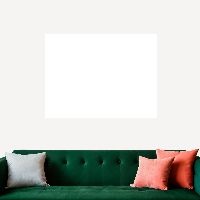

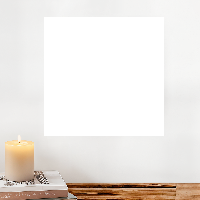

ssssssssssssssssssss
1
1


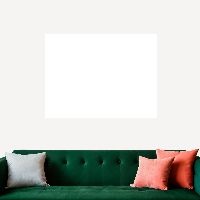

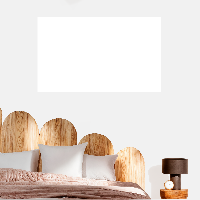

ssssssssssssssssssss
0
0


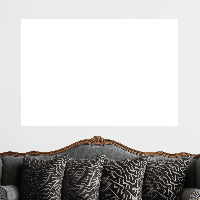

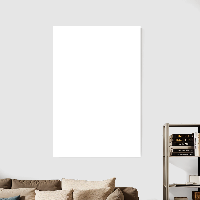

ssssssssssssssssssss
10
10


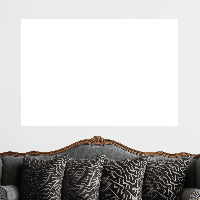

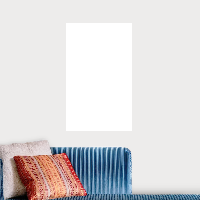

ssssssssssssssssssss
4
4


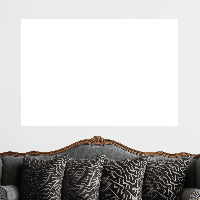

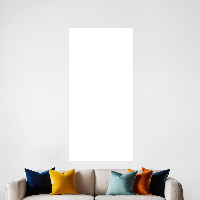

ssssssssssssssssssss
7
7


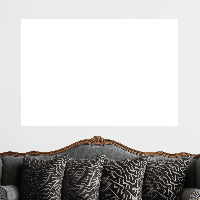

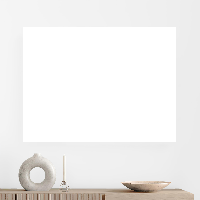

ssssssssssssssssssss
3


In [ ]:

import glob
from rembg import remove
import numpy as np
import cv2
from PIL import Image
import io,csv
from google.colab.patches import cv2_imshow

def show_image(f):
  if isinstance(f,str):
    img1 = cv2.imread(f)
  else:
    img1 = f
  img1 = cv2.resize(img1, (200, 200))
  cv2_imshow(img1)


def compare_sift(img1, img2):
    img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)

    good_matches = [m for m, n in matches if m.distance < 0.55 * n.distance]
    return len(good_matches)


def is_dup(im1,im2):
  _,im1_ = remove_hero_product(im1)
  _,im2_ = remove_hero_product(im2)
  show_image(im1_)
  show_image(   im2_)
  img1 = cv2.imread(im1)
  img2 = cv2.imread(im2)
  try:
    s = compare_sift(img1, img2)
    print("s"*20)
    print(s)
  except Exception as e:
    import traceback
    print(traceback.format_exc())
    print("image failure")
    return False

  if s>40:
    return True
  else:
    return False

def is_dup2(im1,im2):
  # _,im1_ = remove_hero_product(im1)
  # _,im2_ = remove_hero_product(im2)

  img1 = cv2.imread(im1)
  img2 = cv2.imread(im2)
  try:
    s = compare_sift(img1, img2)
    print(s)
  except Exception as e:
    import traceback
    print(traceback.format_exc())
    print("image failure")
    return False

  if s>40:
    return True
  else:
    return False

def is_dup_fname(fname1, fname2):
	fname1 = fname1.split(".")[0]
	base_name1 = fname1.split("-")[0]

	fname2 = fname2.split(".")[0]
	base_name2 = fname2.split("-")[0]

	if base_name1 == base_name2:
		return True

	return False


accuracy = 0
# all_files = [f for f in glob.glob("/content/*.png") if f.split("/")[-1].split(".")[0] in ["3","3-1","3-4"]]
all_files = [f for f in glob.glob("/content/*.png")]
all_files = [f for f in all_files if "hero_removed" not in f]
print(all_files)
csv_file = "duplicates_report.csv"

# Initialize CSV file with headers
headers = ["File Name (Image 1)", "Duplicate File Names"]
with open(csv_file, mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerow(headers)
all_d = {}
compared = []

# Compare images and write duplicates incrementally
for fname1 in all_files:
    duplicates = []
    for fname2 in all_files:
        if fname1 == fname2:
            continue
        if [fname2, fname1] in compared:
            continue
        compared.append([fname1, fname2])

        # Check duplicate flags
        is_dup_flag = is_dup(fname1, fname2)
        is_dup_flag2 = is_dup2(fname1, fname2)
        is_dup_flag_ = is_dup_flag or is_dup_flag2

        if is_dup_flag_:
            duplicates.append(fname2)

    # Update `all_d` and write to CSV
    all_d[fname1] = duplicates
    with open(csv_file, mode="a", newline="") as file:
        writer = csv.writer(file)
        writer.writerow([fname1, ", ".join(duplicates)])  # Write filename and duplicates

print(f"Duplicate report saved incrementally to {csv_file}")

In [ ]:
import pandas as pd
df = pd.read_csv("/content/complete_parsed_output.csv")


*not match*not match*not match*not match*not match*not match*not match*not match*not match*not match


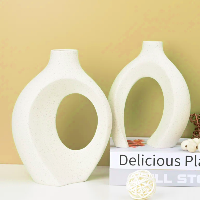

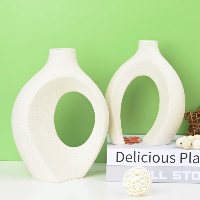

1/9
['/content/dup4/8-1.png', '/content/dup4/8.png']
ssssssssssssssssssss
293
True True


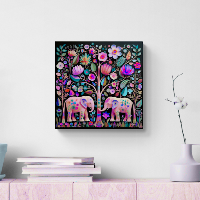

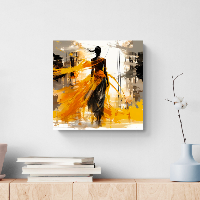

2/9
['/content/dup4/3-1.png', '/content/dup4/3-4.png']
ssssssssssssssssssss
37
False True


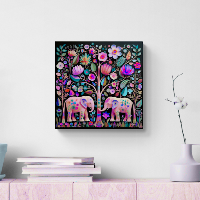

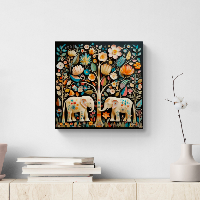

3/9
['/content/dup4/3-1.png', '/content/dup4/3-2.png']
ssssssssssssssssssss
630
True True


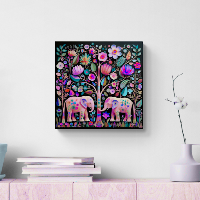

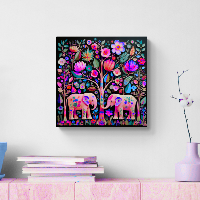

4/9
['/content/dup4/3-1.png', '/content/dup4/3-3.png']
ssssssssssssssssssss
755
True True


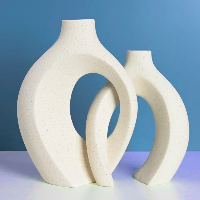

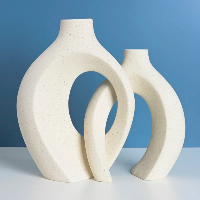

5/9
['/content/dup4/9-1.png', '/content/dup4/9.png']
ssssssssssssssssssss
137
True True


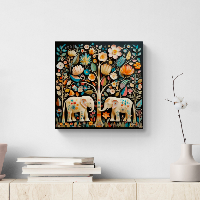

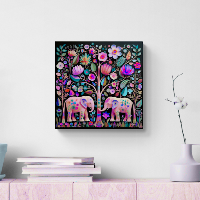

6/9
['/content/dup4/3-2.png', '/content/dup4/3-1.png']
ssssssssssssssssssss
651
True True


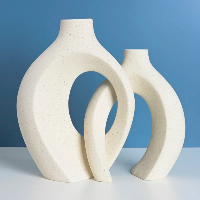

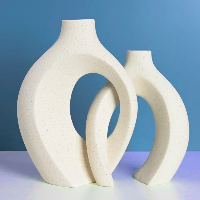

7/9
['/content/dup4/9.png', '/content/dup4/9-1.png']
ssssssssssssssssssss
136
True True


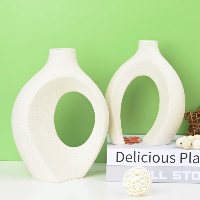

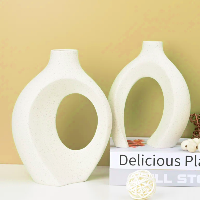

8/9
['/content/dup4/8.png', '/content/dup4/8-1.png']
ssssssssssssssssssss
293
True True


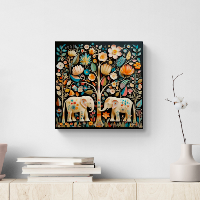

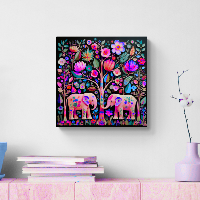

9/9
['/content/dup4/3.png', '/content/dup4/3-3.png']
ssssssssssssssssssss
502
True True
*failure*failure*failure*failure*failure*failure*failure*failure*failure*failure


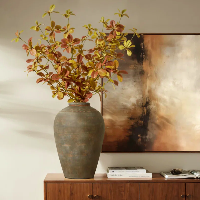

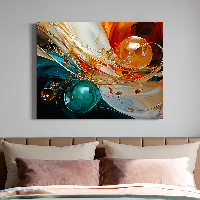

1/54
['/content/dup4/7.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


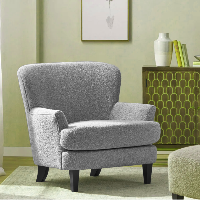

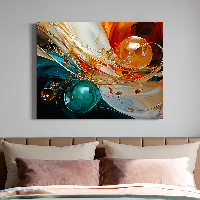

2/54
['/content/dup4/5-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


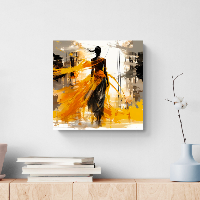

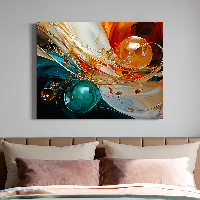

3/54
['/content/dup4/3-4.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


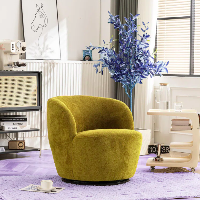

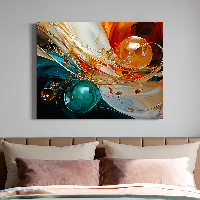

4/54
['/content/dup4/6-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


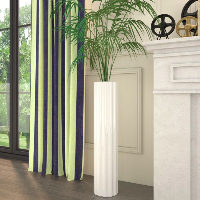

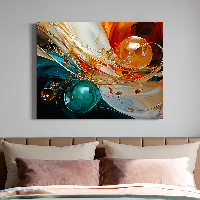

5/54
['/content/dup4/11-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


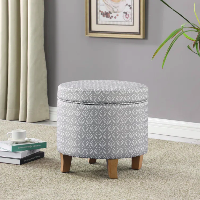

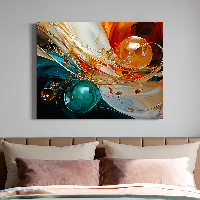

6/54
['/content/dup4/12.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


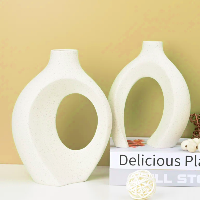

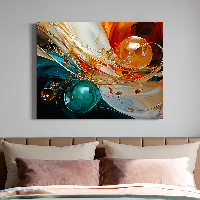

7/54
['/content/dup4/8-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


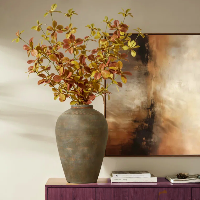

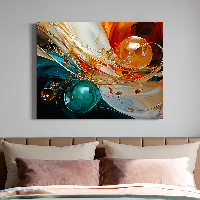

8/54
['/content/dup4/7-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


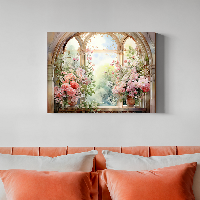

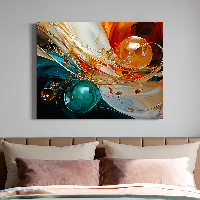

9/54
['/content/dup4/1-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


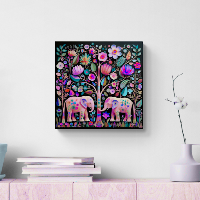

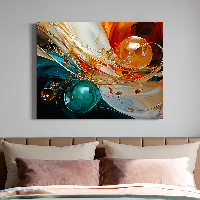

10/54
['/content/dup4/3-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


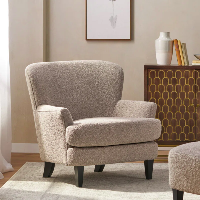

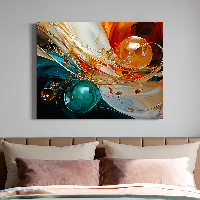

11/54
['/content/dup4/5.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


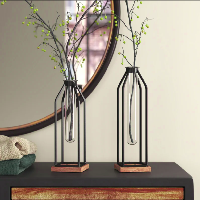

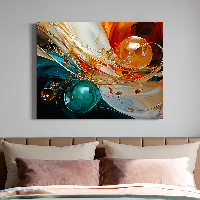

12/54
['/content/dup4/10-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


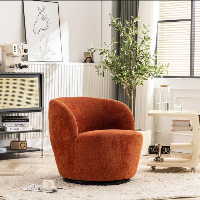

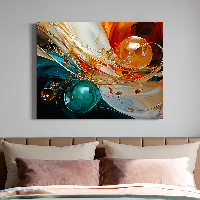

13/54
['/content/dup4/6.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


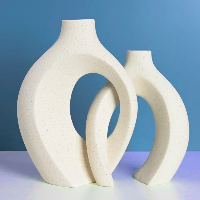

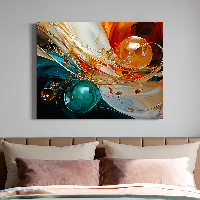

14/54
['/content/dup4/9-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


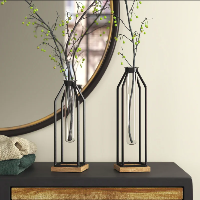

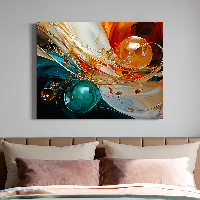

15/54
['/content/dup4/10.png', '/content/dup4/4.png']
ssssssssssssssssssss
2
False False


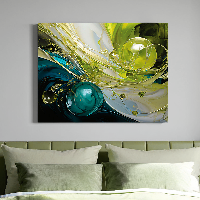

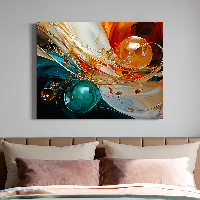

16/54
['/content/dup4/4-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
4743
True True


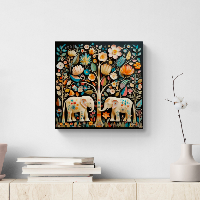

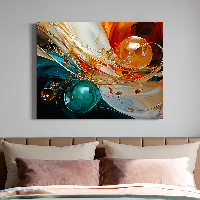

17/54
['/content/dup4/3-2.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


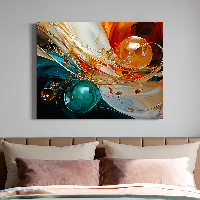

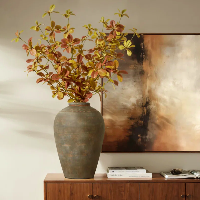

18/54
['/content/dup4/4.png', '/content/dup4/7.png']
ssssssssssssssssssss
18
False False


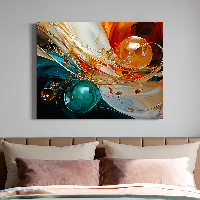

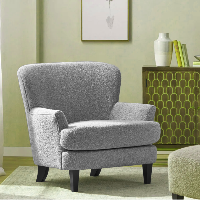

19/54
['/content/dup4/4.png', '/content/dup4/5-1.png']
ssssssssssssssssssss
3
False False


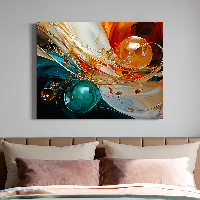

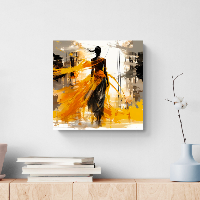

20/54
['/content/dup4/4.png', '/content/dup4/3-4.png']
ssssssssssssssssssss
21
False False


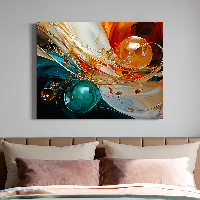

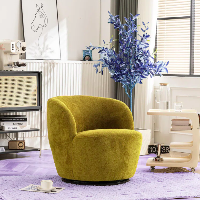

21/54
['/content/dup4/4.png', '/content/dup4/6-1.png']
ssssssssssssssssssss
4
False False


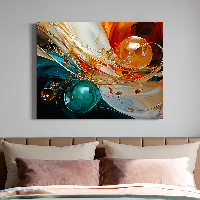

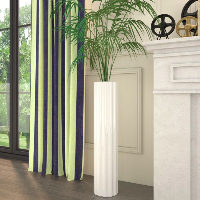

22/54
['/content/dup4/4.png', '/content/dup4/11-1.png']
ssssssssssssssssssss
3
False False


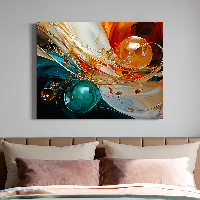

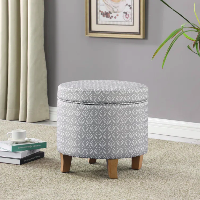

23/54
['/content/dup4/4.png', '/content/dup4/12.png']
ssssssssssssssssssss
15
False False


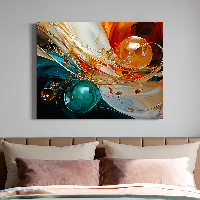

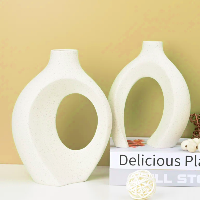

24/54
['/content/dup4/4.png', '/content/dup4/8-1.png']
ssssssssssssssssssss
3
False False


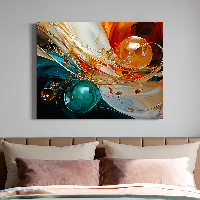

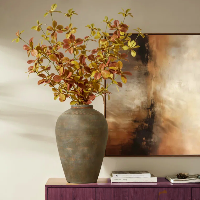

25/54
['/content/dup4/4.png', '/content/dup4/7-1.png']
ssssssssssssssssssss
10
False False


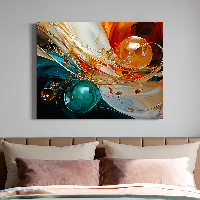

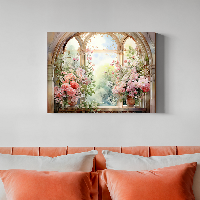

26/54
['/content/dup4/4.png', '/content/dup4/1-1.png']
ssssssssssssssssssss
95
True False


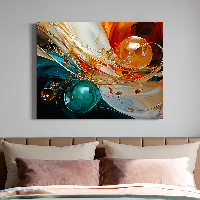

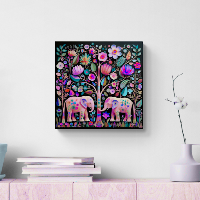

27/54
['/content/dup4/4.png', '/content/dup4/3-1.png']
ssssssssssssssssssss
17
False False


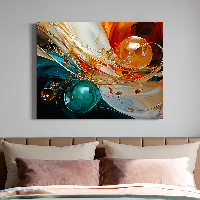

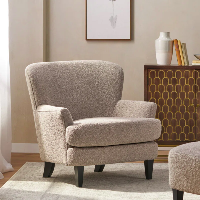

28/54
['/content/dup4/4.png', '/content/dup4/5.png']
ssssssssssssssssssss
2
False False


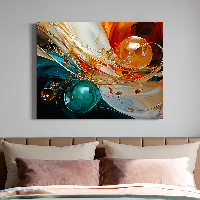

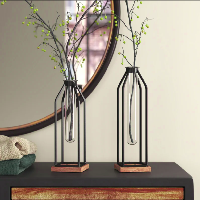

29/54
['/content/dup4/4.png', '/content/dup4/10-1.png']
ssssssssssssssssssss
5
False False


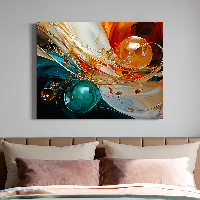

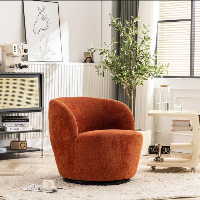

30/54
['/content/dup4/4.png', '/content/dup4/6.png']
ssssssssssssssssssss
5
False False


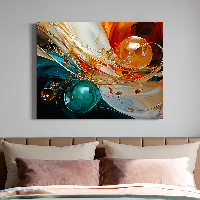

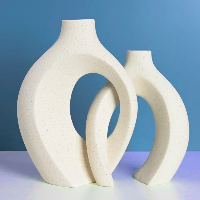

31/54
['/content/dup4/4.png', '/content/dup4/9-1.png']
ssssssssssssssssssss
8
False False


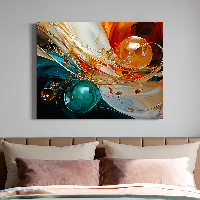

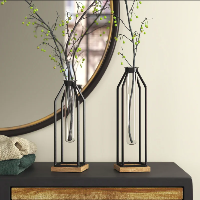

32/54
['/content/dup4/4.png', '/content/dup4/10.png']
ssssssssssssssssssss
5
False False


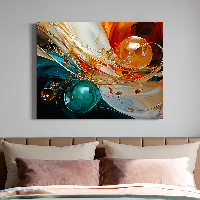

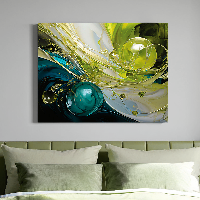

33/54
['/content/dup4/4.png', '/content/dup4/4-1.png']
ssssssssssssssssssss
4659
True True


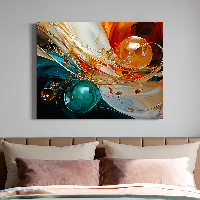

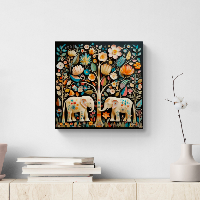

34/54
['/content/dup4/4.png', '/content/dup4/3-2.png']
ssssssssssssssssssss
48
True False


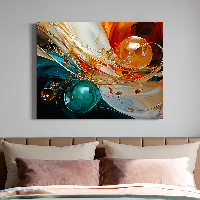

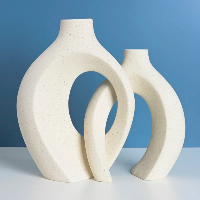

35/54
['/content/dup4/4.png', '/content/dup4/9.png']
ssssssssssssssssssss
10
False False


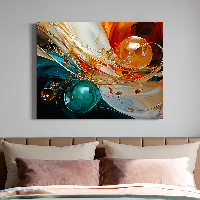

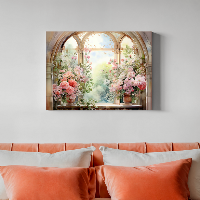

36/54
['/content/dup4/4.png', '/content/dup4/1.png']
ssssssssssssssssssss
95
True False


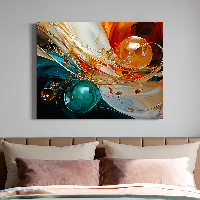

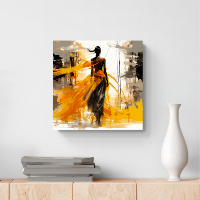

37/54
['/content/dup4/4.png', '/content/dup4/2-1.png']
ssssssssssssssssssss
3
False False


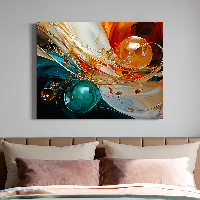

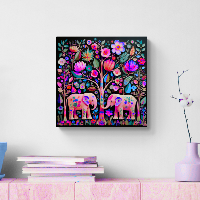

38/54
['/content/dup4/4.png', '/content/dup4/3-3.png']
ssssssssssssssssssss
4
False False


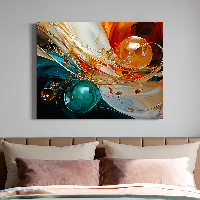

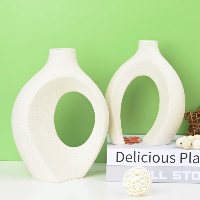

39/54
['/content/dup4/4.png', '/content/dup4/8.png']
ssssssssssssssssssss
3
False False


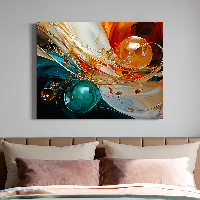

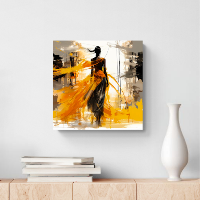

40/54
['/content/dup4/4.png', '/content/dup4/2.png']
ssssssssssssssssssss
3
False False


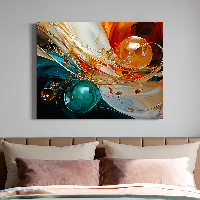

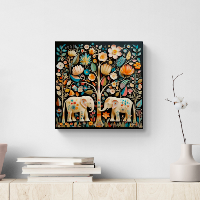

41/54
['/content/dup4/4.png', '/content/dup4/3.png']
ssssssssssssssssssss
1
False False


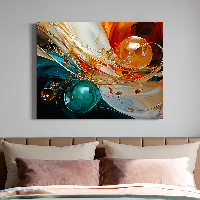

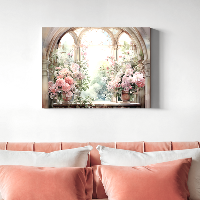

42/54
['/content/dup4/4.png', '/content/dup4/1-2.png']
ssssssssssssssssssss
6
False False


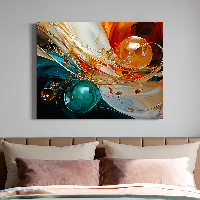

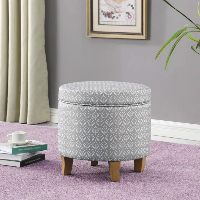

43/54
['/content/dup4/4.png', '/content/dup4/12-1.png']
ssssssssssssssssssss
14
False False


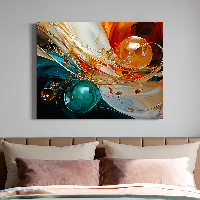

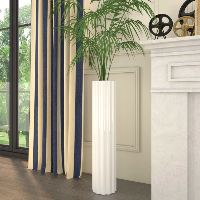

44/54
['/content/dup4/4.png', '/content/dup4/11.png']
ssssssssssssssssssss
3
False False


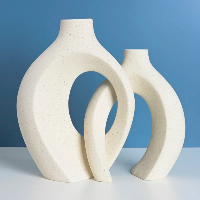

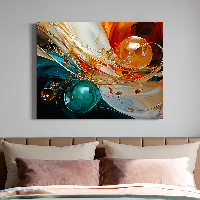

45/54
['/content/dup4/9.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


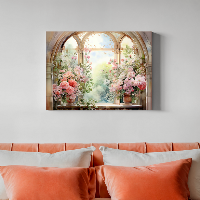

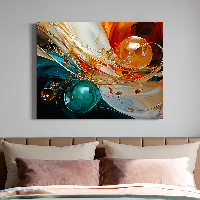

46/54
['/content/dup4/1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


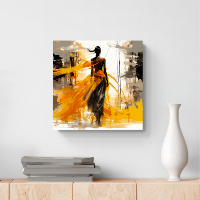

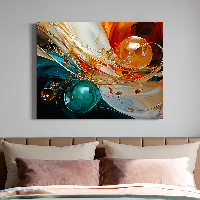

47/54
['/content/dup4/2-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


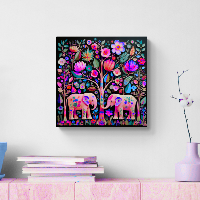

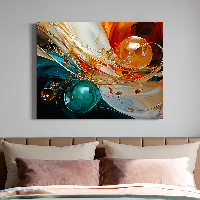

48/54
['/content/dup4/3-3.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


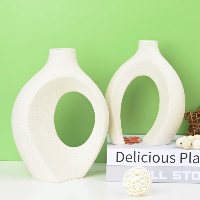

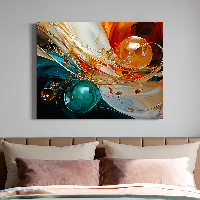

49/54
['/content/dup4/8.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


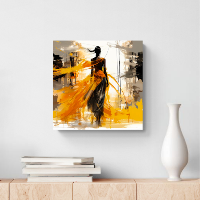

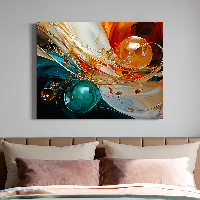

50/54
['/content/dup4/2.png', '/content/dup4/4.png']
ssssssssssssssssssss
1
False False


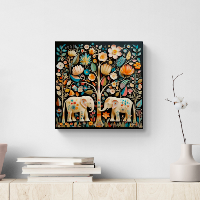

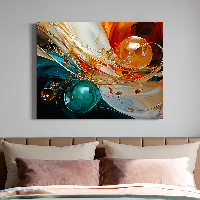

51/54
['/content/dup4/3.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


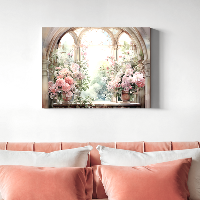

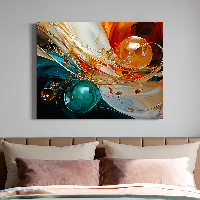

52/54
['/content/dup4/1-2.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


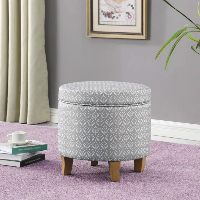

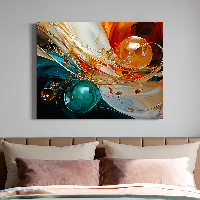

53/54
['/content/dup4/12-1.png', '/content/dup4/4.png']
ssssssssssssssssssss
0
False False


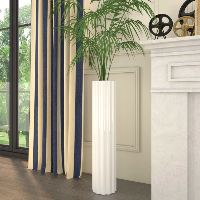

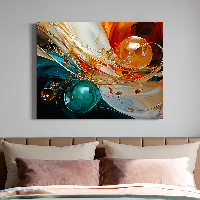

54/54
['/content/dup4/11.png', '/content/dup4/4.png']
ssssssssssssssssssss
3
False False


In [ ]:
nm = []
f = []
for row in df.iterrows():
  if row[1]["Output 1"] in ["image failure"]:
    f.append([row[1]["File 1"],row[1]["File 2"]])
  elif row[1]["Output 1"] in ["not match"]:
    nm.append([row[1]["File 1"],row[1]["File 2"]])
print("*not match"*10)
for k,i in enumerate(nm):
  si(i[0])
  si(i[1])
  print(f"{k+1}/{len(nm)}")
  print(i)
  print(is_dup(i[0], i[1]),is_dup_fname(i[0], i[1]))
print("*failure"*10)
for k,j in enumerate(f):
  si(j[0])
  si(j[1])
  print(f"{k+1}/{len(f)}")
  print(j)
  print(is_dup(j[0], j[1]),is_dup_fname(j[0], j[1]))


In [ ]:
d = [['/content/dup4/10.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/10-1.png', True, True, True, True], ['/content/dup4/10.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/10.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/6-1.png', True, True, True, True], ['/content/dup4/6.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/6.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/1-1.png', True, True, True, True], ['/content/dup4/1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/1-2.png', True, True, True, True], ['/content/dup4/1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/7.png', True, True, True, True], ['/content/dup4/7-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/7-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/11.png', True, True, True, True], ['/content/dup4/11-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/11-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/3-3.png', True, True, True, True], ['/content/dup4/3.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/3-2.png', True, True, True, True], ['/content/dup4/3.png', '/content/dup4/3-1.png', True, True, True, True], ['/content/dup4/3.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/3-4.png', False, False, False, True], ['/content/dup4/3.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/3.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/12-1.png', True, True, True, True], ['/content/dup4/12.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/12.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/9.png', True, True, True, True], ['/content/dup4/9-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/9-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/1.png', True, True, True, True], ['/content/dup4/1-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/1-2.png', True, True, True, True], ['/content/dup4/1-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/1-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/3.png', True, True, True, True], ['/content/dup4/3-3.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/3-2.png', True, True, True, True], ['/content/dup4/3-3.png', '/content/dup4/3-1.png', True, True, True, True], ['/content/dup4/3-3.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/3-4.png', True, True, True, True], ['/content/dup4/3-3.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/3-3.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/1.png', True, True, True, False], ['/content/dup4/4-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/1-1.png', True, True, True, False], ['/content/dup4/4-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/4.png', True, True, True, True], ['/content/dup4/4-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/4-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/12.png', True, True, True, True], ['/content/dup4/12-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/12-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/1.png', True, True, True, False], ['/content/dup4/4.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/1-1.png', True, True, True, False], ['/content/dup4/4.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/4-1.png', True, True, True, True], ['/content/dup4/4.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/3-2.png', True, True, True, False], ['/content/dup4/4.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/4.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/9-1.png', True, True, True, True], ['/content/dup4/9.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/9.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/8-1.png', True, True, True, True], ['/content/dup4/8.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/8.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/8.png', True, True, True, True], ['/content/dup4/8-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/8-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/5.png', '/content/dup4/5-1.png', True, True, True, True], ['/content/dup4/5.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/3-4.png', True, True, True, False], ['/content/dup4/2.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/2.png', '/content/dup4/2-1.png', True, True, True, True], ['/content/dup4/1-2.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/1.png', True, True, True, True], ['/content/dup4/1-2.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/1-1.png', True, True, True, True], ['/content/dup4/1-2.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/1-2.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/7-1.png', True, True, True, True], ['/content/dup4/7.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/7.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/3.png', True, True, True, True], ['/content/dup4/3-2.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/3-3.png', True, True, True, True], ['/content/dup4/3-2.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/3-1.png', True, True, True, True], ['/content/dup4/3-2.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/3-4.png', True, True, True, True], ['/content/dup4/3-2.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/3-2.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/3.png', True, True, True, True], ['/content/dup4/3-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/3-3.png', True, True, True, True], ['/content/dup4/3-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/3-2.png', True, True, True, True], ['/content/dup4/3-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/3-4.png', False, False, False, True], ['/content/dup4/3-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/3-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/6.png', True, True, True, True], ['/content/dup4/6-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/6-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/11-1.png', True, True, True, True], ['/content/dup4/11.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/11.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/10.png', True, True, True, True], ['/content/dup4/10-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/10-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/3.png', False, False, False, True], ['/content/dup4/3-4.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/3-3.png', True, True, True, True], ['/content/dup4/3-4.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/2.png', True, True, True, False], ['/content/dup4/3-4.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/3-2.png', True, True, True, True], ['/content/dup4/3-4.png', '/content/dup4/3-1.png', False, False, False, True], ['/content/dup4/3-4.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/5-1.png', False, False, False, False], ['/content/dup4/3-4.png', '/content/dup4/2-1.png', True, True, True, False], ['/content/dup4/5-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/5.png', True, True, True, True], ['/content/dup4/5-1.png', '/content/dup4/2.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/3-4.png', False, False, False, False], ['/content/dup4/5-1.png', '/content/dup4/2-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/10.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/6.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/7-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/11-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/3.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/12.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/9-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/1-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/3-3.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/4-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/12-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/4.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/9.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/8.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/8-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/5.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/2.png', True, True, True, True], ['/content/dup4/2-1.png', '/content/dup4/1-2.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/7.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/3-2.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/3-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/6-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/11.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/10-1.png', False, False, False, False], ['/content/dup4/2-1.png', '/content/dup4/3-4.png', True, True, True, False], ['/content/dup4/2-1.png', '/content/dup4/5-1.png', False, False, False, False]]


In [ ]:
d2 = [['/content/6-1.png', '/content/2-1.png', False, False, False, False], ['/content/6-1.png', '/content/11-1.png', False, False, False, False], ['/content/6-1.png', '/content/9-1.png', False, False, False, False], ['/content/6-1.png', '/content/3-2.png', False, False, False, False], ['/content/6-1.png', '/content/12-1.png', False, False, False, False], ['/content/6-1.png', '/content/4-1.png', False, False, False, False], ['/content/6-1.png', '/content/11.png', False, False, False, False], ['/content/6-1.png', '/content/8.png', False, False, False, False], ['/content/6-1.png', '/content/3-4.png', False, False, False, False], ['/content/6-1.png', '/content/10.png', False, False, False, False], ['/content/6-1.png', '/content/3-3.png', False, False, False, False], ['/content/6-1.png', '/content/4.png', False, False, False, False], ['/content/6-1.png', '/content/9.png', False, False, False, False], ['/content/6-1.png', '/content/7.png', False, False, False, False], ['/content/6-1.png', '/content/1-1.png', False, False, False, False], ['/content/6-1.png', '/content/5.png', False, False, False, False], ['/content/6-1.png', '/content/6.png', True, True, True, True], ['/content/6-1.png', '/content/8-1.png', False, False, False, False], ['/content/6-1.png', '/content/1-2.png', False, False, False, False], ['/content/6-1.png', '/content/2.png', False, False, False, False], ['/content/6-1.png', '/content/10-1.png', False, False, False, False], ['/content/6-1.png', '/content/12.png', False, False, False, False], ['/content/6-1.png', '/content/3.png', False, False, False, False], ['/content/6-1.png', '/content/5-1.png', False, False, False, False], ['/content/6-1.png', '/content/1.png', False, False, False, False], ['/content/6-1.png', '/content/7-1.png', False, False, False, False], ['/content/6-1.png', '/content/3-1.png', False, False, False, False], ['/content/2-1.png', '/content/6-1.png', False, False, False, False], ['/content/2-1.png', '/content/11-1.png', False, False, False, False], ['/content/2-1.png', '/content/9-1.png', False, False, False, False], ['/content/2-1.png', '/content/3-2.png', False, False, False, False], ['/content/2-1.png', '/content/12-1.png', False, False, False, False], ['/content/2-1.png', '/content/4-1.png', False, False, False, False], ['/content/2-1.png', '/content/11.png', False, False, False, False], ['/content/2-1.png', '/content/8.png', False, False, False, False], ['/content/2-1.png', '/content/3-4.png', True, True, True, False], ['/content/2-1.png', '/content/10.png', False, False, False, False], ['/content/2-1.png', '/content/3-3.png', False, False, False, False], ['/content/2-1.png', '/content/4.png', False, False, False, False], ['/content/2-1.png', '/content/9.png', False, False, False, False], ['/content/2-1.png', '/content/7.png', False, False, False, False], ['/content/2-1.png', '/content/1-1.png', False, False, False, False], ['/content/2-1.png', '/content/5.png', False, False, False, False], ['/content/2-1.png', '/content/6.png', False, False, False, False], ['/content/2-1.png', '/content/8-1.png', False, False, False, False], ['/content/2-1.png', '/content/1-2.png', False, False, False, False], ['/content/2-1.png', '/content/2.png', True, True, True, True], ['/content/2-1.png', '/content/10-1.png', False, False, False, False], ['/content/2-1.png', '/content/12.png', False, False, False, False], ['/content/2-1.png', '/content/3.png', False, False, False, False], ['/content/2-1.png', '/content/5-1.png', False, False, False, False], ['/content/2-1.png', '/content/1.png', False, False, False, False], ['/content/2-1.png', '/content/7-1.png', False, False, False, False], ['/content/2-1.png', '/content/3-1.png', False, False, False, False], ['/content/11-1.png', '/content/6-1.png', False, False, False, False], ['/content/11-1.png', '/content/2-1.png', False, False, False, False], ['/content/11-1.png', '/content/9-1.png', False, False, False, False], ['/content/11-1.png', '/content/3-2.png', False, False, False, False], ['/content/11-1.png', '/content/12-1.png', False, False, False, False], ['/content/11-1.png', '/content/4-1.png', False, False, False, False], ['/content/11-1.png', '/content/11.png', True, True, True, True], ['/content/11-1.png', '/content/8.png', False, False, False, False], ['/content/11-1.png', '/content/3-4.png', False, False, False, False], ['/content/11-1.png', '/content/10.png', False, False, False, False], ['/content/11-1.png', '/content/3-3.png', False, False, False, False], ['/content/11-1.png', '/content/4.png', False, False, False, False], ['/content/11-1.png', '/content/9.png', False, False, False, False], ['/content/11-1.png', '/content/7.png', False, False, False, False], ['/content/11-1.png', '/content/1-1.png', False, False, False, False], ['/content/11-1.png', '/content/5.png', False, False, False, False], ['/content/11-1.png', '/content/6.png', False, False, False, False], ['/content/11-1.png', '/content/8-1.png', False, False, False, False], ['/content/11-1.png', '/content/1-2.png', False, False, False, False], ['/content/11-1.png', '/content/2.png', False, False, False, False], ['/content/11-1.png', '/content/10-1.png', False, False, False, False], ['/content/11-1.png', '/content/12.png', False, False, False, False], ['/content/11-1.png', '/content/3.png', False, False, False, False], ['/content/11-1.png', '/content/5-1.png', False, False, False, False], ['/content/11-1.png', '/content/1.png', False, False, False, False], ['/content/11-1.png', '/content/7-1.png', False, False, False, False], ['/content/11-1.png', '/content/3-1.png', False, False, False, False], ['/content/9-1.png', '/content/6-1.png', False, False, False, False], ['/content/9-1.png', '/content/2-1.png', False, False, False, False], ['/content/9-1.png', '/content/11-1.png', False, False, False, False], ['/content/9-1.png', '/content/3-2.png', False, False, False, False], ['/content/9-1.png', '/content/12-1.png', False, False, False, False], ['/content/9-1.png', '/content/4-1.png', False, False, False, False], ['/content/9-1.png', '/content/11.png', False, False, False, False], ['/content/9-1.png', '/content/8.png', False, False, False, False], ['/content/9-1.png', '/content/3-4.png', False, False, False, False], ['/content/9-1.png', '/content/10.png', False, False, False, False], ['/content/9-1.png', '/content/3-3.png', False, False, False, False], ['/content/9-1.png', '/content/4.png', False, False, False, False], ['/content/9-1.png', '/content/9.png', True, True, True, True], ['/content/9-1.png', '/content/7.png', False, False, False, False], ['/content/9-1.png', '/content/1-1.png', False, False, False, False], ['/content/9-1.png', '/content/5.png', False, False, False, False], ['/content/9-1.png', '/content/6.png', False, False, False, False], ['/content/9-1.png', '/content/8-1.png', False, False, False, False], ['/content/9-1.png', '/content/1-2.png', False, False, False, False], ['/content/9-1.png', '/content/2.png', False, False, False, False], ['/content/9-1.png', '/content/10-1.png', False, False, False, False], ['/content/9-1.png', '/content/12.png', False, False, False, False], ['/content/9-1.png', '/content/3.png', False, False, False, False], ['/content/9-1.png', '/content/5-1.png', False, False, False, False], ['/content/9-1.png', '/content/1.png', False, False, False, False], ['/content/9-1.png', '/content/7-1.png', False, False, False, False], ['/content/9-1.png', '/content/3-1.png', False, False, False, False], ['/content/3-2.png', '/content/6-1.png', False, False, False, False], ['/content/3-2.png', '/content/2-1.png', False, False, False, False], ['/content/3-2.png', '/content/11-1.png', False, False, False, False], ['/content/3-2.png', '/content/9-1.png', False, False, False, False], ['/content/3-2.png', '/content/12-1.png', False, False, False, False], ['/content/3-2.png', '/content/4-1.png', False, False, False, False], ['/content/3-2.png', '/content/11.png', False, False, False, False], ['/content/3-2.png', '/content/8.png', False, False, False, False], ['/content/3-2.png', '/content/3-4.png', True, True, True, True], ['/content/3-2.png', '/content/10.png', False, False, False, False], ['/content/3-2.png', '/content/3-3.png', True, True, True, True], ['/content/3-2.png', '/content/4.png', False, False, False, False], ['/content/3-2.png', '/content/9.png', False, False, False, False], ['/content/3-2.png', '/content/7.png', False, False, False, False], ['/content/3-2.png', '/content/1-1.png', False, False, False, False], ['/content/3-2.png', '/content/5.png', False, False, False, False], ['/content/3-2.png', '/content/6.png', False, False, False, False], ['/content/3-2.png', '/content/8-1.png', False, False, False, False], ['/content/3-2.png', '/content/1-2.png', False, False, False, False], ['/content/3-2.png', '/content/2.png', False, False, False, False], ['/content/3-2.png', '/content/10-1.png', False, False, False, False], ['/content/3-2.png', '/content/12.png', False, False, False, False], ['/content/3-2.png', '/content/3.png', True, True, True, True], ['/content/3-2.png', '/content/5-1.png', False, False, False, False], ['/content/3-2.png', '/content/1.png', False, False, False, False], ['/content/3-2.png', '/content/7-1.png', False, False, False, False], ['/content/3-2.png', '/content/3-1.png', True, True, True, True], ['/content/12-1.png', '/content/6-1.png', False, False, False, False], ['/content/12-1.png', '/content/2-1.png', False, False, False, False], ['/content/12-1.png', '/content/11-1.png', False, False, False, False], ['/content/12-1.png', '/content/9-1.png', False, False, False, False], ['/content/12-1.png', '/content/3-2.png', False, False, False, False], ['/content/12-1.png', '/content/4-1.png', False, False, False, False], ['/content/12-1.png', '/content/11.png', False, False, False, False], ['/content/12-1.png', '/content/8.png', False, False, False, False], ['/content/12-1.png', '/content/3-4.png', False, False, False, False], ['/content/12-1.png', '/content/10.png', False, False, False, False], ['/content/12-1.png', '/content/3-3.png', False, False, False, False], ['/content/12-1.png', '/content/4.png', False, False, False, False], ['/content/12-1.png', '/content/9.png', False, False, False, False], ['/content/12-1.png', '/content/7.png', False, False, False, False], ['/content/12-1.png', '/content/1-1.png', False, False, False, False], ['/content/12-1.png', '/content/5.png', False, False, False, False], ['/content/12-1.png', '/content/6.png', False, False, False, False], ['/content/12-1.png', '/content/8-1.png', False, False, False, False], ['/content/12-1.png', '/content/1-2.png', False, False, False, False], ['/content/12-1.png', '/content/2.png', False, False, False, False], ['/content/12-1.png', '/content/10-1.png', False, False, False, False], ['/content/12-1.png', '/content/12.png', True, True, True, True], ['/content/12-1.png', '/content/3.png', False, False, False, False], ['/content/12-1.png', '/content/5-1.png', False, False, False, False], ['/content/12-1.png', '/content/1.png', False, False, False, False], ['/content/12-1.png', '/content/7-1.png', False, False, False, False], ['/content/12-1.png', '/content/3-1.png', False, False, False, False], ['/content/4-1.png', '/content/6-1.png', False, False, False, False], ['/content/4-1.png', '/content/2-1.png', False, False, False, False], ['/content/4-1.png', '/content/11-1.png', False, False, False, False], ['/content/4-1.png', '/content/9-1.png', False, False, False, False], ['/content/4-1.png', '/content/3-2.png', False, False, False, False], ['/content/4-1.png', '/content/12-1.png', False, False, False, False], ['/content/4-1.png', '/content/11.png', False, False, False, False], ['/content/4-1.png', '/content/8.png', False, False, False, False], ['/content/4-1.png', '/content/3-4.png', False, False, False, False], ['/content/4-1.png', '/content/10.png', False, False, False, False], ['/content/4-1.png', '/content/3-3.png', False, False, False, False], ['/content/4-1.png', '/content/4.png', True, True, True, True], ['/content/4-1.png', '/content/9.png', False, False, False, False], ['/content/4-1.png', '/content/7.png', False, False, False, False], ['/content/4-1.png', '/content/1-1.png', True, True, True, False], ['/content/4-1.png', '/content/5.png', False, False, False, False], ['/content/4-1.png', '/content/6.png', False, False, False, False], ['/content/4-1.png', '/content/8-1.png', False, False, False, False], ['/content/4-1.png', '/content/1-2.png', False, False, False, False], ['/content/4-1.png', '/content/2.png', False, False, False, False], ['/content/4-1.png', '/content/10-1.png', False, False, False, False], ['/content/4-1.png', '/content/12.png', False, False, False, False], ['/content/4-1.png', '/content/3.png', False, False, False, False], ['/content/4-1.png', '/content/5-1.png', False, False, False, False], ['/content/4-1.png', '/content/1.png', True, True, True, False], ['/content/4-1.png', '/content/7-1.png', False, False, False, False], ['/content/4-1.png', '/content/3-1.png', False, False, False, False], ['/content/11.png', '/content/6-1.png', False, False, False, False], ['/content/11.png', '/content/2-1.png', False, False, False, False], ['/content/11.png', '/content/11-1.png', True, True, True, True], ['/content/11.png', '/content/9-1.png', False, False, False, False], ['/content/11.png', '/content/3-2.png', False, False, False, False], ['/content/11.png', '/content/12-1.png', False, False, False, False], ['/content/11.png', '/content/4-1.png', False, False, False, False], ['/content/11.png', '/content/8.png', False, False, False, False], ['/content/11.png', '/content/3-4.png', False, False, False, False], ['/content/11.png', '/content/10.png', False, False, False, False], ['/content/11.png', '/content/3-3.png', False, False, False, False], ['/content/11.png', '/content/4.png', False, False, False, False], ['/content/11.png', '/content/9.png', False, False, False, False], ['/content/11.png', '/content/7.png', False, False, False, False], ['/content/11.png', '/content/1-1.png', False, False, False, False], ['/content/11.png', '/content/5.png', False, False, False, False], ['/content/11.png', '/content/6.png', False, False, False, False], ['/content/11.png', '/content/8-1.png', False, False, False, False], ['/content/11.png', '/content/1-2.png', False, False, False, False], ['/content/11.png', '/content/2.png', False, False, False, False], ['/content/11.png', '/content/10-1.png', False, False, False, False], ['/content/11.png', '/content/12.png', False, False, False, False], ['/content/11.png', '/content/3.png', False, False, False, False], ['/content/11.png', '/content/5-1.png', False, False, False, False], ['/content/11.png', '/content/1.png', False, False, False, False], ['/content/11.png', '/content/7-1.png', False, False, False, False], ['/content/11.png', '/content/3-1.png', False, False, False, False], ['/content/8.png', '/content/6-1.png', False, False, False, False], ['/content/8.png', '/content/2-1.png', False, False, False, False], ['/content/8.png', '/content/11-1.png', False, False, False, False], ['/content/8.png', '/content/9-1.png', False, False, False, False], ['/content/8.png', '/content/3-2.png', False, False, False, False], ['/content/8.png', '/content/12-1.png', False, False, False, False], ['/content/8.png', '/content/4-1.png', False, False, False, False], ['/content/8.png', '/content/11.png', False, False, False, False], ['/content/8.png', '/content/3-4.png', False, False, False, False], ['/content/8.png', '/content/10.png', False, False, False, False], ['/content/8.png', '/content/3-3.png', False, False, False, False], ['/content/8.png', '/content/4.png', False, False, False, False], ['/content/8.png', '/content/9.png', False, False, False, False], ['/content/8.png', '/content/7.png', False, False, False, False], ['/content/8.png', '/content/1-1.png', False, False, False, False], ['/content/8.png', '/content/5.png', False, False, False, False], ['/content/8.png', '/content/6.png', False, False, False, False], ['/content/8.png', '/content/8-1.png', True, True, True, True], ['/content/8.png', '/content/1-2.png', False, False, False, False], ['/content/8.png', '/content/2.png', False, False, False, False], ['/content/8.png', '/content/10-1.png', False, False, False, False], ['/content/8.png', '/content/12.png', False, False, False, False], ['/content/8.png', '/content/3.png', False, False, False, False], ['/content/8.png', '/content/5-1.png', False, False, False, False], ['/content/8.png', '/content/1.png', False, False, False, False], ['/content/8.png', '/content/7-1.png', False, False, False, False], ['/content/8.png', '/content/3-1.png', False, False, False, False], ['/content/3-4.png', '/content/6-1.png', False, False, False, False], ['/content/3-4.png', '/content/2-1.png', True, True, True, False], ['/content/3-4.png', '/content/11-1.png', False, False, False, False], ['/content/3-4.png', '/content/9-1.png', False, False, False, False], ['/content/3-4.png', '/content/3-2.png', True, True, True, True], ['/content/3-4.png', '/content/12-1.png', False, False, False, False], ['/content/3-4.png', '/content/4-1.png', False, False, False, False], ['/content/3-4.png', '/content/11.png', False, False, False, False], ['/content/3-4.png', '/content/8.png', False, False, False, False], ['/content/3-4.png', '/content/10.png', False, False, False, False], ['/content/3-4.png', '/content/3-3.png', True, True, True, True], ['/content/3-4.png', '/content/4.png', False, False, False, False], ['/content/3-4.png', '/content/9.png', False, False, False, False], ['/content/3-4.png', '/content/7.png', False, False, False, False], ['/content/3-4.png', '/content/1-1.png', False, False, False, False], ['/content/3-4.png', '/content/5.png', False, False, False, False], ['/content/3-4.png', '/content/6.png', False, False, False, False], ['/content/3-4.png', '/content/8-1.png', False, False, False, False], ['/content/3-4.png', '/content/1-2.png', False, False, False, False], ['/content/3-4.png', '/content/2.png', True, True, True, False], ['/content/3-4.png', '/content/10-1.png', False, False, False, False], ['/content/3-4.png', '/content/12.png', False, False, False, False], ['/content/3-4.png', '/content/3.png', False, False, False, True], ['/content/3-4.png', '/content/5-1.png', False, False, False, False], ['/content/3-4.png', '/content/1.png', False, False, False, False], ['/content/3-4.png', '/content/7-1.png', False, False, False, False], ['/content/3-4.png', '/content/3-1.png', False, False, False, True], ['/content/10.png', '/content/6-1.png', False, False, False, False], ['/content/10.png', '/content/2-1.png', False, False, False, False], ['/content/10.png', '/content/11-1.png', False, False, False, False], ['/content/10.png', '/content/9-1.png', False, False, False, False], ['/content/10.png', '/content/3-2.png', False, False, False, False], ['/content/10.png', '/content/12-1.png', False, False, False, False], ['/content/10.png', '/content/4-1.png', False, False, False, False], ['/content/10.png', '/content/11.png', False, False, False, False], ['/content/10.png', '/content/8.png', False, False, False, False], ['/content/10.png', '/content/3-4.png', False, False, False, False], ['/content/10.png', '/content/3-3.png', False, False, False, False], ['/content/10.png', '/content/4.png', False, False, False, False], ['/content/10.png', '/content/9.png', False, False, False, False], ['/content/10.png', '/content/7.png', False, False, False, False], ['/content/10.png', '/content/1-1.png', False, False, False, False], ['/content/10.png', '/content/5.png', False, False, False, False], ['/content/10.png', '/content/6.png', False, False, False, False], ['/content/10.png', '/content/8-1.png', False, False, False, False], ['/content/10.png', '/content/1-2.png', False, False, False, False], ['/content/10.png', '/content/2.png', False, False, False, False], ['/content/10.png', '/content/10-1.png', True, True, True, True], ['/content/10.png', '/content/12.png', False, False, False, False], ['/content/10.png', '/content/3.png', False, False, False, False], ['/content/10.png', '/content/5-1.png', False, False, False, False], ['/content/10.png', '/content/1.png', False, False, False, False], ['/content/10.png', '/content/7-1.png', False, False, False, False], ['/content/10.png', '/content/3-1.png', False, False, False, False], ['/content/3-3.png', '/content/6-1.png', False, False, False, False], ['/content/3-3.png', '/content/2-1.png', False, False, False, False], ['/content/3-3.png', '/content/11-1.png', False, False, False, False], ['/content/3-3.png', '/content/9-1.png', False, False, False, False], ['/content/3-3.png', '/content/3-2.png', True, True, True, True], ['/content/3-3.png', '/content/12-1.png', False, False, False, False], ['/content/3-3.png', '/content/4-1.png', False, False, False, False], ['/content/3-3.png', '/content/11.png', False, False, False, False], ['/content/3-3.png', '/content/8.png', False, False, False, False], ['/content/3-3.png', '/content/3-4.png', True, True, True, True], ['/content/3-3.png', '/content/10.png', False, False, False, False], ['/content/3-3.png', '/content/4.png', False, False, False, False], ['/content/3-3.png', '/content/9.png', False, False, False, False], ['/content/3-3.png', '/content/7.png', False, False, False, False], ['/content/3-3.png', '/content/1-1.png', False, False, False, False], ['/content/3-3.png', '/content/5.png', False, False, False, False], ['/content/3-3.png', '/content/6.png', False, False, False, False], ['/content/3-3.png', '/content/8-1.png', False, False, False, False], ['/content/3-3.png', '/content/1-2.png', False, False, False, False], ['/content/3-3.png', '/content/2.png', False, False, False, False], ['/content/3-3.png', '/content/10-1.png', False, False, False, False], ['/content/3-3.png', '/content/12.png', False, False, False, False], ['/content/3-3.png', '/content/3.png', True, True, True, True], ['/content/3-3.png', '/content/5-1.png', False, False, False, False], ['/content/3-3.png', '/content/1.png', False, False, False, False], ['/content/3-3.png', '/content/7-1.png', False, False, False, False], ['/content/3-3.png', '/content/3-1.png', True, True, True, True], ['/content/4.png', '/content/6-1.png', False, False, False, False], ['/content/4.png', '/content/2-1.png', False, False, False, False], ['/content/4.png', '/content/11-1.png', False, False, False, False], ['/content/4.png', '/content/9-1.png', False, False, False, False], ['/content/4.png', '/content/3-2.png', True, True, True, False], ['/content/4.png', '/content/12-1.png', False, False, False, False], ['/content/4.png', '/content/4-1.png', True, True, True, True], ['/content/4.png', '/content/11.png', False, False, False, False], ['/content/4.png', '/content/8.png', False, False, False, False], ['/content/4.png', '/content/3-4.png', False, False, False, False], ['/content/4.png', '/content/10.png', False, False, False, False], ['/content/4.png', '/content/3-3.png', False, False, False, False], ['/content/4.png', '/content/9.png', False, False, False, False], ['/content/4.png', '/content/7.png', False, False, False, False], ['/content/4.png', '/content/1-1.png', True, True, True, False], ['/content/4.png', '/content/5.png', False, False, False, False], ['/content/4.png', '/content/6.png', False, False, False, False], ['/content/4.png', '/content/8-1.png', False, False, False, False], ['/content/4.png', '/content/1-2.png', False, False, False, False], ['/content/4.png', '/content/2.png', False, False, False, False], ['/content/4.png', '/content/10-1.png', False, False, False, False], ['/content/4.png', '/content/12.png', False, False, False, False], ['/content/4.png', '/content/3.png', False, False, False, False], ['/content/4.png', '/content/5-1.png', False, False, False, False], ['/content/4.png', '/content/1.png', True, True, True, False], ['/content/4.png', '/content/7-1.png', False, False, False, False], ['/content/4.png', '/content/3-1.png', False, False, False, False], ['/content/9.png', '/content/6-1.png', False, False, False, False], ['/content/9.png', '/content/2-1.png', False, False, False, False], ['/content/9.png', '/content/11-1.png', False, False, False, False], ['/content/9.png', '/content/9-1.png', True, True, True, True], ['/content/9.png', '/content/3-2.png', False, False, False, False], ['/content/9.png', '/content/12-1.png', False, False, False, False], ['/content/9.png', '/content/4-1.png', False, False, False, False], ['/content/9.png', '/content/11.png', False, False, False, False], ['/content/9.png', '/content/8.png', False, False, False, False], ['/content/9.png', '/content/3-4.png', False, False, False, False], ['/content/9.png', '/content/10.png', False, False, False, False], ['/content/9.png', '/content/3-3.png', False, False, False, False], ['/content/9.png', '/content/4.png', False, False, False, False], ['/content/9.png', '/content/7.png', False, False, False, False], ['/content/9.png', '/content/1-1.png', False, False, False, False], ['/content/9.png', '/content/5.png', False, False, False, False], ['/content/9.png', '/content/6.png', False, False, False, False], ['/content/9.png', '/content/8-1.png', False, False, False, False], ['/content/9.png', '/content/1-2.png', False, False, False, False], ['/content/9.png', '/content/2.png', False, False, False, False], ['/content/9.png', '/content/10-1.png', False, False, False, False], ['/content/9.png', '/content/12.png', False, False, False, False], ['/content/9.png', '/content/3.png', False, False, False, False], ['/content/9.png', '/content/5-1.png', False, False, False, False], ['/content/9.png', '/content/1.png', False, False, False, False], ['/content/9.png', '/content/7-1.png', False, False, False, False], ['/content/9.png', '/content/3-1.png', False, False, False, False], ['/content/7.png', '/content/6-1.png', False, False, False, False], ['/content/7.png', '/content/2-1.png', False, False, False, False], ['/content/7.png', '/content/11-1.png', False, False, False, False], ['/content/7.png', '/content/9-1.png', False, False, False, False], ['/content/7.png', '/content/3-2.png', False, False, False, False], ['/content/7.png', '/content/12-1.png', False, False, False, False], ['/content/7.png', '/content/4-1.png', False, False, False, False], ['/content/7.png', '/content/11.png', False, False, False, False], ['/content/7.png', '/content/8.png', False, False, False, False], ['/content/7.png', '/content/3-4.png', False, False, False, False], ['/content/7.png', '/content/10.png', False, False, False, False], ['/content/7.png', '/content/3-3.png', False, False, False, False], ['/content/7.png', '/content/4.png', False, False, False, False], ['/content/7.png', '/content/9.png', False, False, False, False], ['/content/7.png', '/content/1-1.png', False, False, False, False], ['/content/7.png', '/content/5.png', False, False, False, False], ['/content/7.png', '/content/6.png', False, False, False, False], ['/content/7.png', '/content/8-1.png', False, False, False, False], ['/content/7.png', '/content/1-2.png', False, False, False, False], ['/content/7.png', '/content/2.png', False, False, False, False], ['/content/7.png', '/content/10-1.png', False, False, False, False], ['/content/7.png', '/content/12.png', False, False, False, False], ['/content/7.png', '/content/3.png', False, False, False, False], ['/content/7.png', '/content/5-1.png', False, False, False, False], ['/content/7.png', '/content/1.png', False, False, False, False], ['/content/7.png', '/content/7-1.png', True, True, True, True], ['/content/7.png', '/content/3-1.png', False, False, False, False], ['/content/1-1.png', '/content/6-1.png', False, False, False, False], ['/content/1-1.png', '/content/2-1.png', False, False, False, False], ['/content/1-1.png', '/content/11-1.png', False, False, False, False], ['/content/1-1.png', '/content/9-1.png', False, False, False, False], ['/content/1-1.png', '/content/3-2.png', False, False, False, False], ['/content/1-1.png', '/content/12-1.png', False, False, False, False], ['/content/1-1.png', '/content/4-1.png', False, False, False, False], ['/content/1-1.png', '/content/11.png', False, False, False, False], ['/content/1-1.png', '/content/8.png', False, False, False, False], ['/content/1-1.png', '/content/3-4.png', False, False, False, False], ['/content/1-1.png', '/content/10.png', False, False, False, False], ['/content/1-1.png', '/content/3-3.png', False, False, False, False], ['/content/1-1.png', '/content/4.png', False, False, False, False], ['/content/1-1.png', '/content/9.png', False, False, False, False], ['/content/1-1.png', '/content/7.png', False, False, False, False], ['/content/1-1.png', '/content/5.png', False, False, False, False], ['/content/1-1.png', '/content/6.png', False, False, False, False], ['/content/1-1.png', '/content/8-1.png', False, False, False, False], ['/content/1-1.png', '/content/1-2.png', True, True, True, True], ['/content/1-1.png', '/content/2.png', False, False, False, False], ['/content/1-1.png', '/content/10-1.png', False, False, False, False], ['/content/1-1.png', '/content/12.png', False, False, False, False], ['/content/1-1.png', '/content/3.png', False, False, False, False], ['/content/1-1.png', '/content/5-1.png', False, False, False, False], ['/content/1-1.png', '/content/1.png', True, True, True, True], ['/content/1-1.png', '/content/7-1.png', False, False, False, False], ['/content/1-1.png', '/content/3-1.png', False, False, False, False], ['/content/5.png', '/content/6-1.png', False, False, False, False], ['/content/5.png', '/content/2-1.png', False, False, False, False], ['/content/5.png', '/content/11-1.png', False, False, False, False], ['/content/5.png', '/content/9-1.png', False, False, False, False], ['/content/5.png', '/content/3-2.png', False, False, False, False], ['/content/5.png', '/content/12-1.png', False, False, False, False], ['/content/5.png', '/content/4-1.png', False, False, False, False], ['/content/5.png', '/content/11.png', False, False, False, False], ['/content/5.png', '/content/8.png', False, False, False, False], ['/content/5.png', '/content/3-4.png', False, False, False, False], ['/content/5.png', '/content/10.png', False, False, False, False], ['/content/5.png', '/content/3-3.png', False, False, False, False], ['/content/5.png', '/content/4.png', False, False, False, False], ['/content/5.png', '/content/9.png', False, False, False, False], ['/content/5.png', '/content/7.png', False, False, False, False], ['/content/5.png', '/content/1-1.png', False, False, False, False], ['/content/5.png', '/content/6.png', False, False, False, False], ['/content/5.png', '/content/8-1.png', False, False, False, False], ['/content/5.png', '/content/1-2.png', False, False, False, False], ['/content/5.png', '/content/2.png', False, False, False, False], ['/content/5.png', '/content/10-1.png', False, False, False, False], ['/content/5.png', '/content/12.png', False, False, False, False], ['/content/5.png', '/content/3.png', False, False, False, False], ['/content/5.png', '/content/5-1.png', True, True, True, True], ['/content/5.png', '/content/1.png', False, False, False, False], ['/content/5.png', '/content/7-1.png', False, False, False, False], ['/content/5.png', '/content/3-1.png', False, False, False, False], ['/content/6.png', '/content/6-1.png', True, True, True, True], ['/content/6.png', '/content/2-1.png', False, False, False, False], ['/content/6.png', '/content/11-1.png', False, False, False, False], ['/content/6.png', '/content/9-1.png', False, False, False, False], ['/content/6.png', '/content/3-2.png', False, False, False, False], ['/content/6.png', '/content/12-1.png', False, False, False, False], ['/content/6.png', '/content/4-1.png', False, False, False, False], ['/content/6.png', '/content/11.png', False, False, False, False], ['/content/6.png', '/content/8.png', False, False, False, False], ['/content/6.png', '/content/3-4.png', False, False, False, False], ['/content/6.png', '/content/10.png', False, False, False, False], ['/content/6.png', '/content/3-3.png', False, False, False, False], ['/content/6.png', '/content/4.png', False, False, False, False], ['/content/6.png', '/content/9.png', False, False, False, False], ['/content/6.png', '/content/7.png', False, False, False, False], ['/content/6.png', '/content/1-1.png', False, False, False, False], ['/content/6.png', '/content/5.png', False, False, False, False], ['/content/6.png', '/content/8-1.png', False, False, False, False], ['/content/6.png', '/content/1-2.png', False, False, False, False], ['/content/6.png', '/content/2.png', False, False, False, False], ['/content/6.png', '/content/10-1.png', False, False, False, False], ['/content/6.png', '/content/12.png', False, False, False, False], ['/content/6.png', '/content/3.png', False, False, False, False], ['/content/6.png', '/content/5-1.png', False, False, False, False], ['/content/6.png', '/content/1.png', False, False, False, False], ['/content/6.png', '/content/7-1.png', False, False, False, False], ['/content/6.png', '/content/3-1.png', False, False, False, False], ['/content/8-1.png', '/content/6-1.png', False, False, False, False], ['/content/8-1.png', '/content/2-1.png', False, False, False, False], ['/content/8-1.png', '/content/11-1.png', False, False, False, False], ['/content/8-1.png', '/content/9-1.png', False, False, False, False], ['/content/8-1.png', '/content/3-2.png', False, False, False, False], ['/content/8-1.png', '/content/12-1.png', False, False, False, False], ['/content/8-1.png', '/content/4-1.png', False, False, False, False], ['/content/8-1.png', '/content/11.png', False, False, False, False], ['/content/8-1.png', '/content/8.png', True, True, True, True], ['/content/8-1.png', '/content/3-4.png', False, False, False, False], ['/content/8-1.png', '/content/10.png', False, False, False, False], ['/content/8-1.png', '/content/3-3.png', False, False, False, False], ['/content/8-1.png', '/content/4.png', False, False, False, False], ['/content/8-1.png', '/content/9.png', False, False, False, False], ['/content/8-1.png', '/content/7.png', False, False, False, False], ['/content/8-1.png', '/content/1-1.png', False, False, False, False], ['/content/8-1.png', '/content/5.png', False, False, False, False], ['/content/8-1.png', '/content/6.png', False, False, False, False], ['/content/8-1.png', '/content/1-2.png', False, False, False, False], ['/content/8-1.png', '/content/2.png', False, False, False, False], ['/content/8-1.png', '/content/10-1.png', False, False, False, False], ['/content/8-1.png', '/content/12.png', False, False, False, False], ['/content/8-1.png', '/content/3.png', False, False, False, False], ['/content/8-1.png', '/content/5-1.png', False, False, False, False], ['/content/8-1.png', '/content/1.png', False, False, False, False], ['/content/8-1.png', '/content/7-1.png', False, False, False, False], ['/content/8-1.png', '/content/3-1.png', False, False, False, False], ['/content/1-2.png', '/content/6-1.png', False, False, False, False], ['/content/1-2.png', '/content/2-1.png', False, False, False, False], ['/content/1-2.png', '/content/11-1.png', False, False, False, False], ['/content/1-2.png', '/content/9-1.png', False, False, False, False], ['/content/1-2.png', '/content/3-2.png', False, False, False, False], ['/content/1-2.png', '/content/12-1.png', False, False, False, False], ['/content/1-2.png', '/content/4-1.png', False, False, False, False], ['/content/1-2.png', '/content/11.png', False, False, False, False], ['/content/1-2.png', '/content/8.png', False, False, False, False], ['/content/1-2.png', '/content/3-4.png', False, False, False, False], ['/content/1-2.png', '/content/10.png', False, False, False, False], ['/content/1-2.png', '/content/3-3.png', False, False, False, False], ['/content/1-2.png', '/content/4.png', False, False, False, False], ['/content/1-2.png', '/content/9.png', False, False, False, False], ['/content/1-2.png', '/content/7.png', False, False, False, False], ['/content/1-2.png', '/content/1-1.png', True, True, True, True], ['/content/1-2.png', '/content/5.png', False, False, False, False], ['/content/1-2.png', '/content/6.png', False, False, False, False], ['/content/1-2.png', '/content/8-1.png', False, False, False, False], ['/content/1-2.png', '/content/2.png', False, False, False, False], ['/content/1-2.png', '/content/10-1.png', False, False, False, False], ['/content/1-2.png', '/content/12.png', False, False, False, False], ['/content/1-2.png', '/content/3.png', False, False, False, False], ['/content/1-2.png', '/content/5-1.png', False, False, False, False], ['/content/1-2.png', '/content/1.png', True, True, True, True], ['/content/1-2.png', '/content/7-1.png', False, False, False, False], ['/content/1-2.png', '/content/3-1.png', False, False, False, False], ['/content/2.png', '/content/6-1.png', False, False, False, False], ['/content/2.png', '/content/2-1.png', True, True, True, True], ['/content/2.png', '/content/11-1.png', False, False, False, False], ['/content/2.png', '/content/9-1.png', False, False, False, False], ['/content/2.png', '/content/3-2.png', False, False, False, False], ['/content/2.png', '/content/12-1.png', False, False, False, False], ['/content/2.png', '/content/4-1.png', False, False, False, False], ['/content/2.png', '/content/11.png', False, False, False, False], ['/content/2.png', '/content/8.png', False, False, False, False], ['/content/2.png', '/content/3-4.png', True, True, True, False], ['/content/2.png', '/content/10.png', False, False, False, False], ['/content/2.png', '/content/3-3.png', False, False, False, False], ['/content/2.png', '/content/4.png', False, False, False, False], ['/content/2.png', '/content/9.png', False, False, False, False], ['/content/2.png', '/content/7.png', False, False, False, False], ['/content/2.png', '/content/1-1.png', False, False, False, False], ['/content/2.png', '/content/5.png', False, False, False, False], ['/content/2.png', '/content/6.png', False, False, False, False], ['/content/2.png', '/content/8-1.png', False, False, False, False], ['/content/2.png', '/content/1-2.png', False, False, False, False], ['/content/2.png', '/content/10-1.png', False, False, False, False], ['/content/2.png', '/content/12.png', False, False, False, False], ['/content/2.png', '/content/3.png', False, False, False, False], ['/content/2.png', '/content/5-1.png', False, False, False, False], ['/content/2.png', '/content/1.png', False, False, False, False], ['/content/2.png', '/content/7-1.png', False, False, False, False], ['/content/2.png', '/content/3-1.png', False, False, False, False], ['/content/10-1.png', '/content/6-1.png', False, False, False, False], ['/content/10-1.png', '/content/2-1.png', False, False, False, False], ['/content/10-1.png', '/content/11-1.png', False, False, False, False], ['/content/10-1.png', '/content/9-1.png', False, False, False, False], ['/content/10-1.png', '/content/3-2.png', False, False, False, False], ['/content/10-1.png', '/content/12-1.png', False, False, False, False], ['/content/10-1.png', '/content/4-1.png', False, False, False, False], ['/content/10-1.png', '/content/11.png', False, False, False, False], ['/content/10-1.png', '/content/8.png', False, False, False, False], ['/content/10-1.png', '/content/3-4.png', False, False, False, False], ['/content/10-1.png', '/content/10.png', True, True, True, True], ['/content/10-1.png', '/content/3-3.png', False, False, False, False], ['/content/10-1.png', '/content/4.png', False, False, False, False], ['/content/10-1.png', '/content/9.png', False, False, False, False], ['/content/10-1.png', '/content/7.png', False, False, False, False], ['/content/10-1.png', '/content/1-1.png', False, False, False, False], ['/content/10-1.png', '/content/5.png', False, False, False, False], ['/content/10-1.png', '/content/6.png', False, False, False, False], ['/content/10-1.png', '/content/8-1.png', False, False, False, False], ['/content/10-1.png', '/content/1-2.png', False, False, False, False], ['/content/10-1.png', '/content/2.png', False, False, False, False], ['/content/10-1.png', '/content/12.png', False, False, False, False], ['/content/10-1.png', '/content/3.png', False, False, False, False], ['/content/10-1.png', '/content/5-1.png', False, False, False, False], ['/content/10-1.png', '/content/1.png', False, False, False, False], ['/content/10-1.png', '/content/7-1.png', False, False, False, False], ['/content/10-1.png', '/content/3-1.png', False, False, False, False], ['/content/12.png', '/content/6-1.png', False, False, False, False], ['/content/12.png', '/content/2-1.png', False, False, False, False], ['/content/12.png', '/content/11-1.png', False, False, False, False], ['/content/12.png', '/content/9-1.png', False, False, False, False], ['/content/12.png', '/content/3-2.png', False, False, False, False], ['/content/12.png', '/content/12-1.png', True, True, True, True], ['/content/12.png', '/content/4-1.png', False, False, False, False], ['/content/12.png', '/content/11.png', False, False, False, False], ['/content/12.png', '/content/8.png', False, False, False, False], ['/content/12.png', '/content/3-4.png', False, False, False, False], ['/content/12.png', '/content/10.png', False, False, False, False], ['/content/12.png', '/content/3-3.png', False, False, False, False], ['/content/12.png', '/content/4.png', False, False, False, False], ['/content/12.png', '/content/9.png', False, False, False, False], ['/content/12.png', '/content/7.png', False, False, False, False], ['/content/12.png', '/content/1-1.png', False, False, False, False], ['/content/12.png', '/content/5.png', False, False, False, False], ['/content/12.png', '/content/6.png', False, False, False, False], ['/content/12.png', '/content/8-1.png', False, False, False, False], ['/content/12.png', '/content/1-2.png', False, False, False, False], ['/content/12.png', '/content/2.png', False, False, False, False], ['/content/12.png', '/content/10-1.png', False, False, False, False], ['/content/12.png', '/content/3.png', False, False, False, False], ['/content/12.png', '/content/5-1.png', False, False, False, False], ['/content/12.png', '/content/1.png', False, False, False, False], ['/content/12.png', '/content/7-1.png', False, False, False, False], ['/content/12.png', '/content/3-1.png', False, False, False, False], ['/content/3.png', '/content/6-1.png', False, False, False, False], ['/content/3.png', '/content/2-1.png', False, False, False, False], ['/content/3.png', '/content/11-1.png', False, False, False, False], ['/content/3.png', '/content/9-1.png', False, False, False, False], ['/content/3.png', '/content/3-2.png', True, True, True, True], ['/content/3.png', '/content/12-1.png', False, False, False, False], ['/content/3.png', '/content/4-1.png', False, False, False, False], ['/content/3.png', '/content/11.png', False, False, False, False], ['/content/3.png', '/content/8.png', False, False, False, False], ['/content/3.png', '/content/3-4.png', False, False, False, True], ['/content/3.png', '/content/10.png', False, False, False, False], ['/content/3.png', '/content/3-3.png', True, True, True, True], ['/content/3.png', '/content/4.png', False, False, False, False], ['/content/3.png', '/content/9.png', False, False, False, False], ['/content/3.png', '/content/7.png', False, False, False, False], ['/content/3.png', '/content/1-1.png', False, False, False, False], ['/content/3.png', '/content/5.png', False, False, False, False], ['/content/3.png', '/content/6.png', False, False, False, False], ['/content/3.png', '/content/8-1.png', False, False, False, False], ['/content/3.png', '/content/1-2.png', False, False, False, False], ['/content/3.png', '/content/2.png', False, False, False, False], ['/content/3.png', '/content/10-1.png', False, False, False, False], ['/content/3.png', '/content/12.png', False, False, False, False], ['/content/3.png', '/content/5-1.png', False, False, False, False], ['/content/3.png', '/content/1.png', False, False, False, False], ['/content/3.png', '/content/7-1.png', False, False, False, False], ['/content/3.png', '/content/3-1.png', True, True, True, True], ['/content/5-1.png', '/content/6-1.png', False, False, False, False], ['/content/5-1.png', '/content/2-1.png', False, False, False, False], ['/content/5-1.png', '/content/11-1.png', False, False, False, False], ['/content/5-1.png', '/content/9-1.png', False, False, False, False], ['/content/5-1.png', '/content/3-2.png', False, False, False, False], ['/content/5-1.png', '/content/12-1.png', False, False, False, False], ['/content/5-1.png', '/content/4-1.png', False, False, False, False], ['/content/5-1.png', '/content/11.png', False, False, False, False], ['/content/5-1.png', '/content/8.png', False, False, False, False], ['/content/5-1.png', '/content/3-4.png', False, False, False, False], ['/content/5-1.png', '/content/10.png', False, False, False, False], ['/content/5-1.png', '/content/3-3.png', False, False, False, False], ['/content/5-1.png', '/content/4.png', False, False, False, False], ['/content/5-1.png', '/content/9.png', False, False, False, False], ['/content/5-1.png', '/content/7.png', False, False, False, False], ['/content/5-1.png', '/content/1-1.png', False, False, False, False], ['/content/5-1.png', '/content/5.png', True, True, True, True], ['/content/5-1.png', '/content/6.png', False, False, False, False], ['/content/5-1.png', '/content/8-1.png', False, False, False, False], ['/content/5-1.png', '/content/1-2.png', False, False, False, False], ['/content/5-1.png', '/content/2.png', False, False, False, False], ['/content/5-1.png', '/content/10-1.png', False, False, False, False], ['/content/5-1.png', '/content/12.png', False, False, False, False], ['/content/5-1.png', '/content/3.png', False, False, False, False], ['/content/5-1.png', '/content/1.png', False, False, False, False], ['/content/5-1.png', '/content/7-1.png', False, False, False, False], ['/content/5-1.png', '/content/3-1.png', False, False, False, False], ['/content/1.png', '/content/6-1.png', False, False, False, False], ['/content/1.png', '/content/2-1.png', False, False, False, False], ['/content/1.png', '/content/11-1.png', False, False, False, False], ['/content/1.png', '/content/9-1.png', False, False, False, False], ['/content/1.png', '/content/3-2.png', False, False, False, False], ['/content/1.png', '/content/12-1.png', False, False, False, False], ['/content/1.png', '/content/4-1.png', False, False, False, False], ['/content/1.png', '/content/11.png', False, False, False, False], ['/content/1.png', '/content/8.png', False, False, False, False], ['/content/1.png', '/content/3-4.png', False, False, False, False], ['/content/1.png', '/content/10.png', False, False, False, False], ['/content/1.png', '/content/3-3.png', False, False, False, False], ['/content/1.png', '/content/4.png', False, False, False, False], ['/content/1.png', '/content/9.png', False, False, False, False], ['/content/1.png', '/content/7.png', False, False, False, False], ['/content/1.png', '/content/1-1.png', True, True, True, True], ['/content/1.png', '/content/5.png', False, False, False, False], ['/content/1.png', '/content/6.png', False, False, False, False], ['/content/1.png', '/content/8-1.png', False, False, False, False], ['/content/1.png', '/content/1-2.png', True, True, True, True], ['/content/1.png', '/content/2.png', False, False, False, False], ['/content/1.png', '/content/10-1.png', False, False, False, False], ['/content/1.png', '/content/12.png', False, False, False, False], ['/content/1.png', '/content/3.png', False, False, False, False], ['/content/1.png', '/content/5-1.png', False, False, False, False], ['/content/1.png', '/content/7-1.png', False, False, False, False], ['/content/1.png', '/content/3-1.png', False, False, False, False], ['/content/7-1.png', '/content/6-1.png', False, False, False, False], ['/content/7-1.png', '/content/2-1.png', False, False, False, False], ['/content/7-1.png', '/content/11-1.png', False, False, False, False], ['/content/7-1.png', '/content/9-1.png', False, False, False, False], ['/content/7-1.png', '/content/3-2.png', False, False, False, False], ['/content/7-1.png', '/content/12-1.png', False, False, False, False], ['/content/7-1.png', '/content/4-1.png', False, False, False, False], ['/content/7-1.png', '/content/11.png', False, False, False, False], ['/content/7-1.png', '/content/8.png', False, False, False, False], ['/content/7-1.png', '/content/3-4.png', False, False, False, False], ['/content/7-1.png', '/content/10.png', False, False, False, False], ['/content/7-1.png', '/content/3-3.png', False, False, False, False], ['/content/7-1.png', '/content/4.png', False, False, False, False], ['/content/7-1.png', '/content/9.png', False, False, False, False], ['/content/7-1.png', '/content/7.png', True, True, True, True], ['/content/7-1.png', '/content/1-1.png', False, False, False, False], ['/content/7-1.png', '/content/5.png', False, False, False, False], ['/content/7-1.png', '/content/6.png', False, False, False, False], ['/content/7-1.png', '/content/8-1.png', False, False, False, False], ['/content/7-1.png', '/content/1-2.png', False, False, False, False], ['/content/7-1.png', '/content/2.png', False, False, False, False], ['/content/7-1.png', '/content/10-1.png', False, False, False, False], ['/content/7-1.png', '/content/12.png', False, False, False, False], ['/content/7-1.png', '/content/3.png', False, False, False, False], ['/content/7-1.png', '/content/5-1.png', False, False, False, False], ['/content/7-1.png', '/content/1.png', False, False, False, False], ['/content/7-1.png', '/content/3-1.png', False, False, False, False], ['/content/3-1.png', '/content/6-1.png', False, False, False, False], ['/content/3-1.png', '/content/2-1.png', False, False, False, False], ['/content/3-1.png', '/content/11-1.png', False, False, False, False], ['/content/3-1.png', '/content/9-1.png', False, False, False, False], ['/content/3-1.png', '/content/3-2.png', True, True, True, True], ['/content/3-1.png', '/content/12-1.png', False, False, False, False], ['/content/3-1.png', '/content/4-1.png', False, False, False, False], ['/content/3-1.png', '/content/11.png', False, False, False, False], ['/content/3-1.png', '/content/8.png', False, False, False, False], ['/content/3-1.png', '/content/3-4.png', False, False, False, True], ['/content/3-1.png', '/content/10.png', False, False, False, False], ['/content/3-1.png', '/content/3-3.png', True, True, True, True], ['/content/3-1.png', '/content/4.png', False, False, False, False], ['/content/3-1.png', '/content/9.png', False, False, False, False], ['/content/3-1.png', '/content/7.png', False, False, False, False], ['/content/3-1.png', '/content/1-1.png', False, False, False, False], ['/content/3-1.png', '/content/5.png', False, False, False, False], ['/content/3-1.png', '/content/6.png', False, False, False, False], ['/content/3-1.png', '/content/8-1.png', False, False, False, False], ['/content/3-1.png', '/content/1-2.png', False, False, False, False], ['/content/3-1.png', '/content/2.png', False, False, False, False], ['/content/3-1.png', '/content/10-1.png', False, False, False, False], ['/content/3-1.png', '/content/12.png', False, False, False, False], ['/content/3-1.png', '/content/3.png', True, True, True, True], ['/content/3-1.png', '/content/5-1.png', False, False, False, False], ['/content/3-1.png', '/content/1.png', False, False, False, False], ['/content/3-1.png', '/content/7-1.png', False, False, False, False]]


In [17]:
import pandas as pd
import numpy as np
df = pd.DataFrame(columns=["f1","f2","1","2","3","4"],data=all_d)

In [18]:
# prompt: find precision and recall  for each class column "3" is output and "4" is groundtruth.

from sklearn.metrics import precision_score, recall_score

# Assuming 'df' is your DataFrame and columns '3' and '4' represent predictions and ground truth respectively.
# Replace '3' and '4' with the actual column names if they are different.

# Convert the prediction and ground truth columns to numerical arrays
y_pred = df['3'].astype(int).values
y_true = df['4'].astype(int).values

# Calculate precision and recall for each class
precision = precision_score(y_true, y_pred, average=None)
recall = recall_score(y_true, y_pred, average=None)

# Print the results
for i, (p, r) in enumerate(zip(precision, recall)):
    print(f"Class {i}: Precision={p:.2f}, Recall={r:.2f}")

# Calculate macro-averaged precision and recall (optional)
macro_precision = precision_score(y_true, y_pred, average='macro')
macro_recall = recall_score(y_true, y_pred, average='macro')

print(f"\nMacro-averaged Precision: {macro_precision:.2f}")
print(f"Macro-averaged Recall: {macro_recall:.2f}")

Class 0: Precision=1.00, Recall=0.98
Class 1: Precision=0.79, Recall=1.00

Macro-averaged Precision: 0.90
Macro-averaged Recall: 0.99


In [19]:
for d in df.iterrows():
  if d[1]["3"]!= d[1]["4"] and d[1]["4"]==True:
    print(d[1])
